In [1]:
from utils import *

# Explorative analysis - Clusterings

In [2]:
respondents, results, cardsE, cardsB = loadData()

## Clustering (BMM) visualizations

#### Study variants

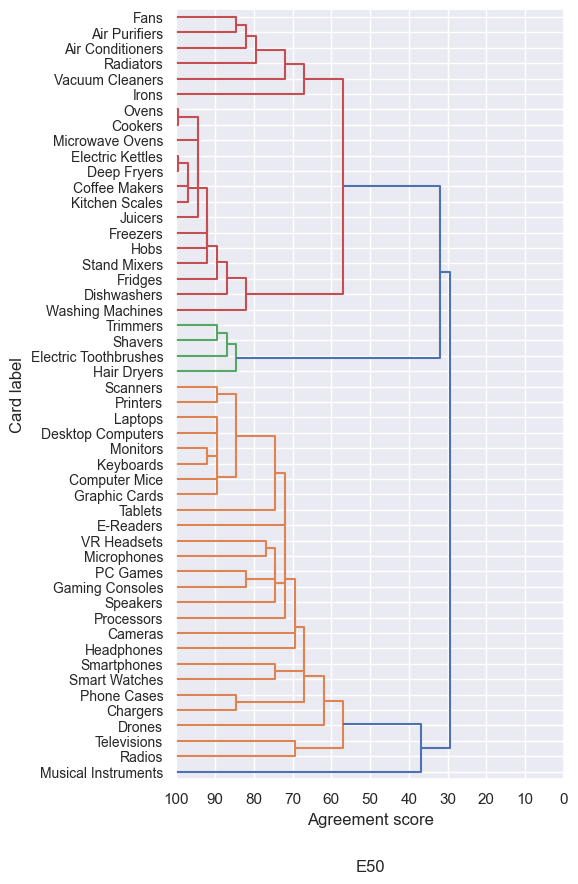

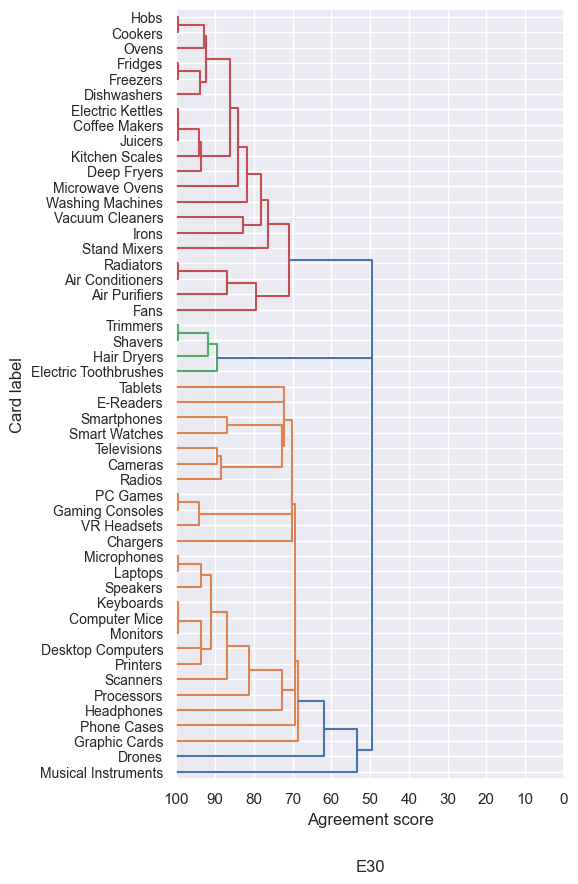

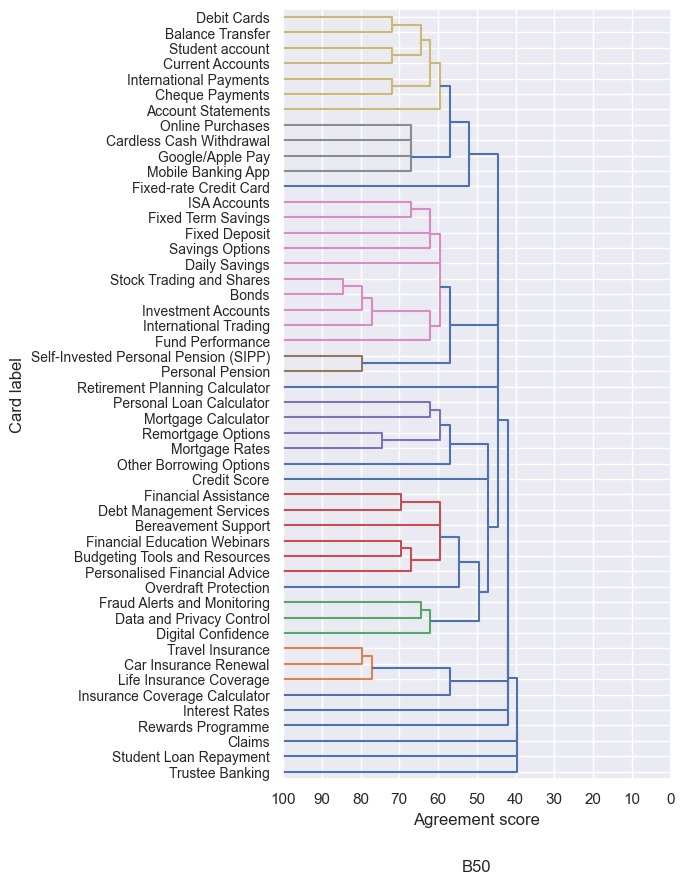

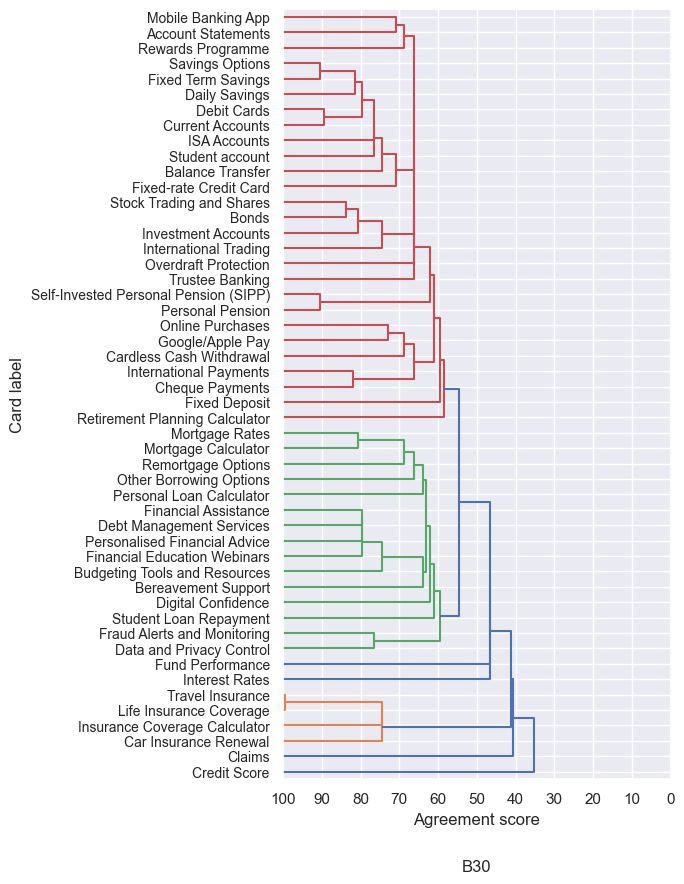

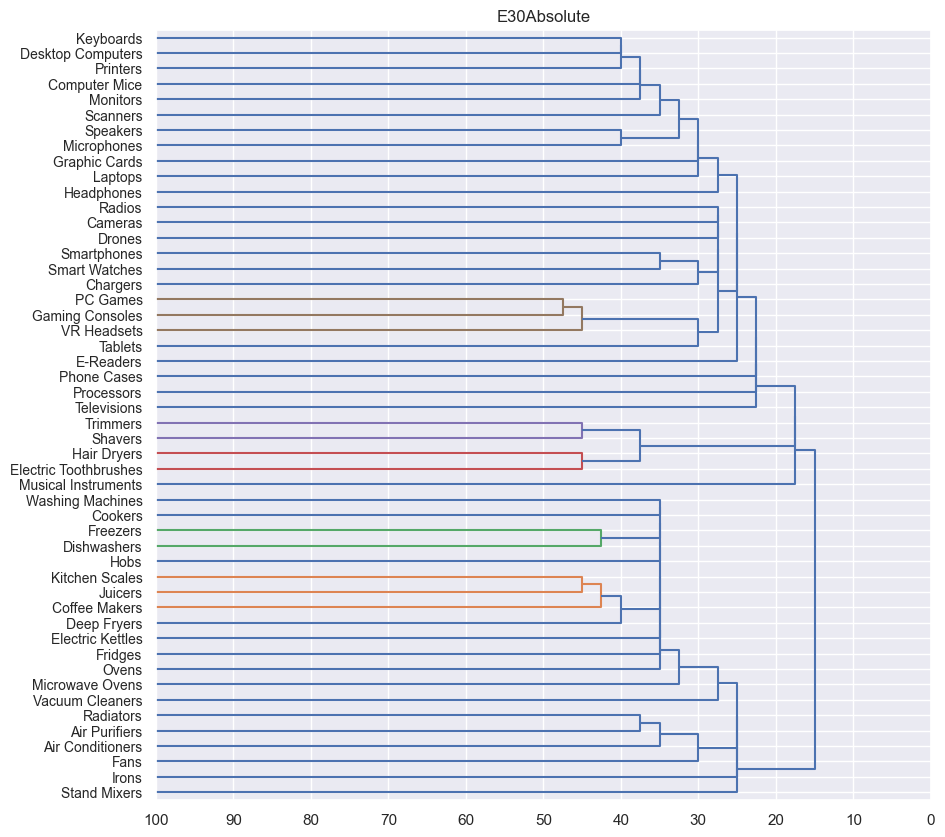

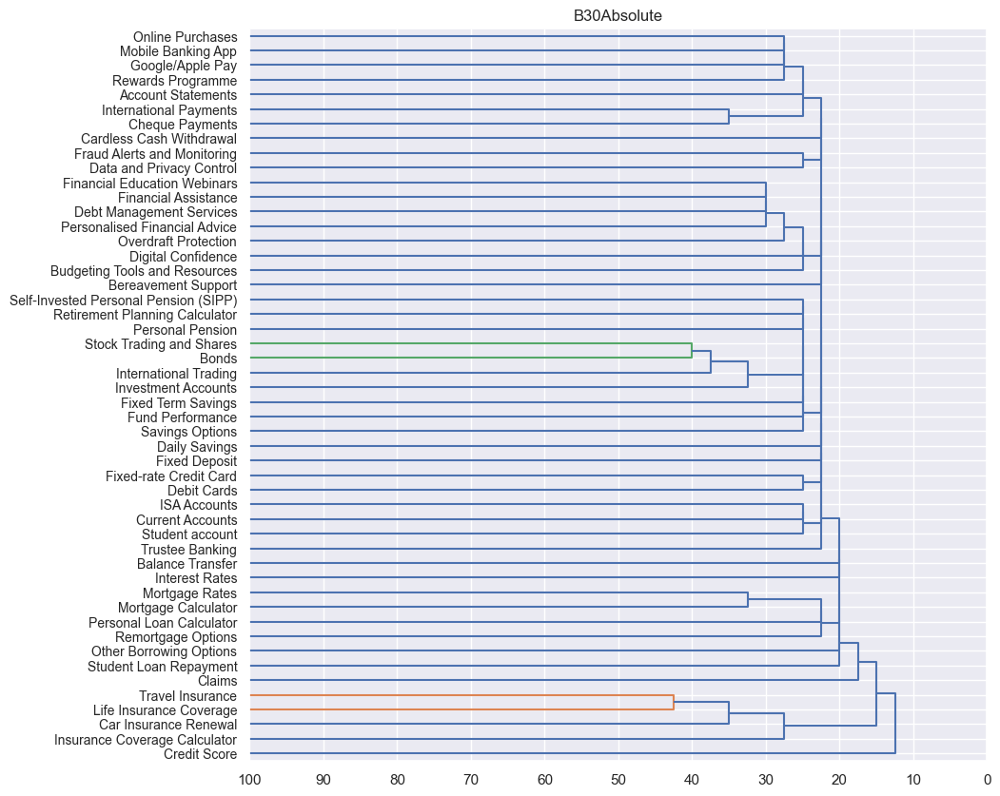

In [3]:
sns.set_theme(style='darkgrid')
for v in ['E50', 'E30', 'B50', 'B30']:
    sim = makeMatrix('similarity', results[results.variant==v], cardsE if v in ['E50', 'E30'] else cardsB, 40)
    m = 1 - (np.matrix(sim) / 100) + .005
    np.fill_diagonal(m, 0)
    l = linkage(squareform(m), method='single')
    plt.figure(figsize=(5, 10))
    dendrogram(l, labels=sim.index, orientation='right', leaf_font_size=10)
    plt.xticks(np.arange(0, 1.1, step=0.1), labels=list(map(lambda x: int(np.round(x*100)),np.arange(1, -0.1, step=-0.1))))
    plt.xlabel('Agreement score')
    plt.ylabel('Card label')
    plt.title(v, y=-0.13)
    plt.show()

for v in ['E30', 'B30']:
    sim = makeMatrix('similarityAbsolute', results[results.variant==v], cardsE if v in ['E50', 'E30'] else cardsB, 40)
    m = 1 - (np.matrix(sim) / 100)
    np.fill_diagonal(m, 0)
    l = linkage(squareform(m), method='single')
    plt.figure(figsize=(10, 10))
    dendrogram(l, labels=sim.index, orientation='right', leaf_font_size=10)
    plt.title(v + 'Absolute')
    plt.xticks(np.arange(0, 1.1, step=0.1), labels=list(map(lambda x: int(np.round(x*100)),np.arange(1, -0.1, step=-0.1))))
    plt.show()

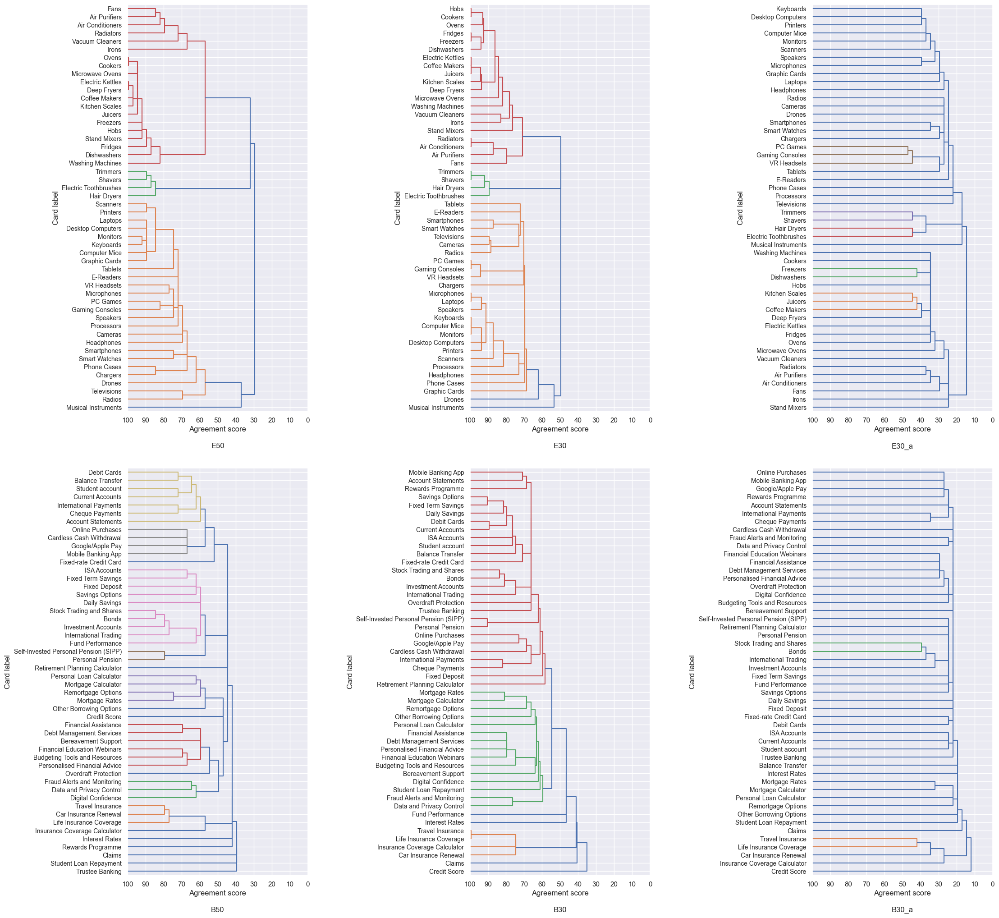

In [4]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(nrows=2, ncols=3, figsize=(20, 20))
figures = {'E50': ax1, 'E30': ax2, 'E30_a': ax3, 'B50': ax4, 'B30': ax5, 'B30_a': ax6}
fig.tight_layout()
for v in figures:
    if(v == 'E30_a'):
        sim = makeMatrix('similarityAbsolute', results[results.variant=='E30'], cardsE, 40)
    elif(v == 'B30_a'):
        sim = makeMatrix('similarityAbsolute', results[results.variant=='B30'], cardsB, 40)
    else:
        sim = makeMatrix('similarity', results[results.variant==v], cardsE if v in ['E50', 'E30'] else cardsB, 40)
    m = 1 - (np.matrix(sim) / 100) + .005
    np.fill_diagonal(m, 0)
    l = linkage(squareform(m), method='single')
    dendrogram(l, labels=sim.index, orientation='right', leaf_font_size=10, ax=figures[v])
    figures[v].set_title(v, y=-0.1)
    figures[v].set_xticks(np.arange(0, 1.1, step=0.1), labels=list(map(lambda x: int(np.round(x*100)),np.arange(1, -0.1, step=-0.1))))
    figures[v].set_xlabel('Agreement score')
    figures[v].set_ylabel('Card label')
    plt.subplots_adjust(hspace=0.14, wspace=0.9)

In [35]:
agreements = {}
for v in ['E50', 'E30', 'B50', 'B30']:
    x, y = makeMatrix('C-similarity', results[results.variant==v], cardsE if v in ['E50', 'E30'] else cardsB, 40, clusterHistory=True)
    agreements[v] = [d['agreement'] for d in y]
    if v.endswith('30'):
        x, y = makeMatrix('C-similarityAbsolute', results[results.variant==v], cardsE if v in ['E50', 'E30'] else cardsB, 40, clusterHistory=True)
        agreements[v+'A'] = [d['agreement'] for d in y]

In [ ]:
pd.DataFrame(agreements).mean()

E50     79.183673
E30     84.622992
E30A    32.551020
B50     60.816327
B30     69.778269
B30A    25.459184
dtype: float64

In [39]:
pd.DataFrame(agreements).tail()

,E50,E30,E30A,B50,B30,B30A
44,57.5,69.230769,22.5,42.5,47.058824,20.0
45,57.5,62.500000,22.5,42.5,47.058824,20.0
46,37.5,53.846154,17.5,40.0,41.666667,17.5
47,32.5,50.000000,17.5,40.0,41.176471,15.0
48,30.0,50.000000,15.0,40.0,35.714286,12.5


### Big5, CRT

/var/folders/3m/cjzjfzb55vz43fmr0ny8vj6w0000gn/T/ipykernel_5291/1085872952.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 12))


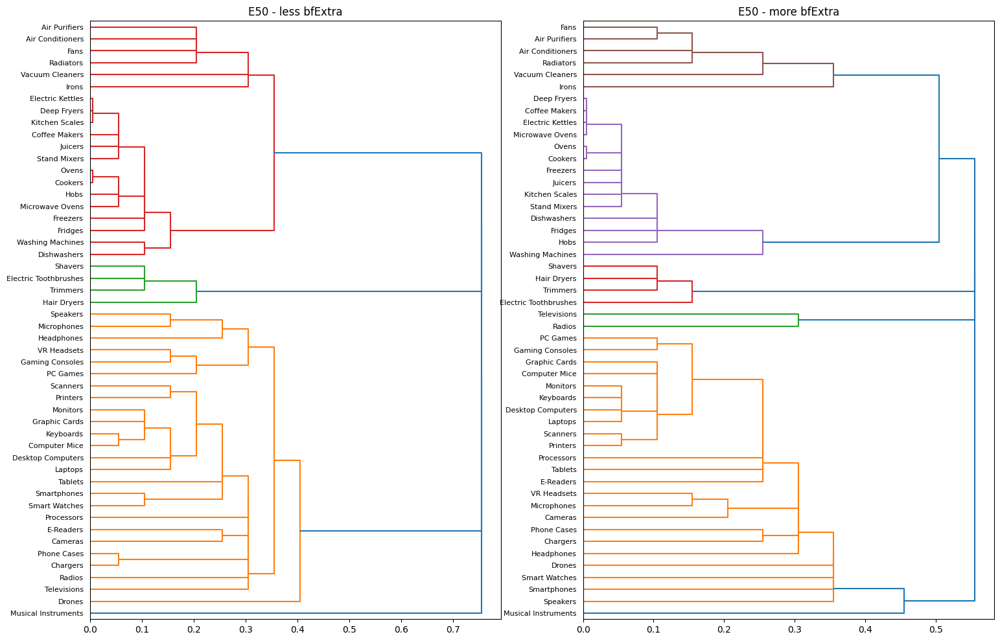

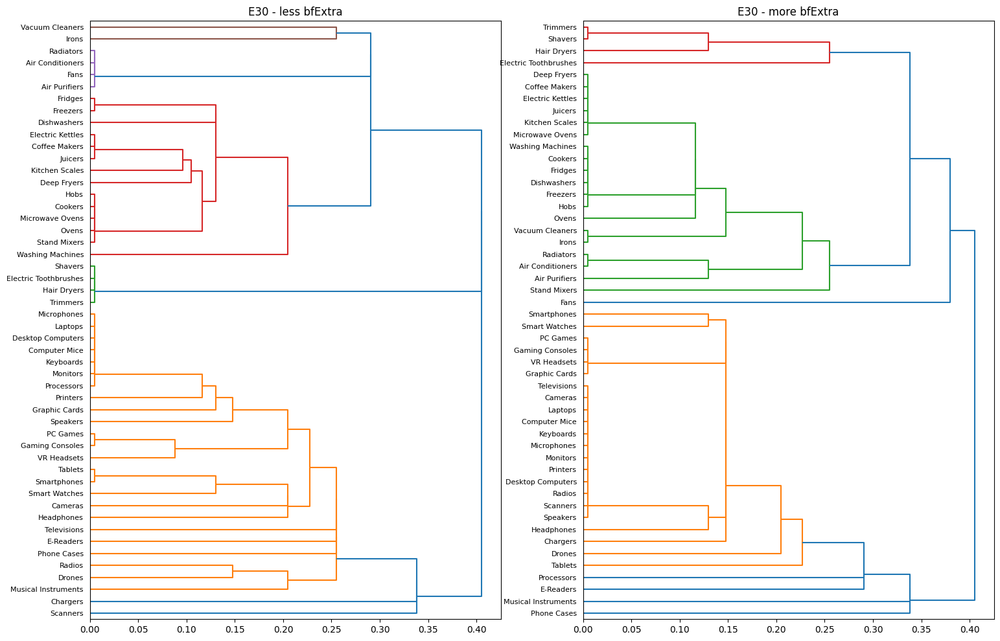

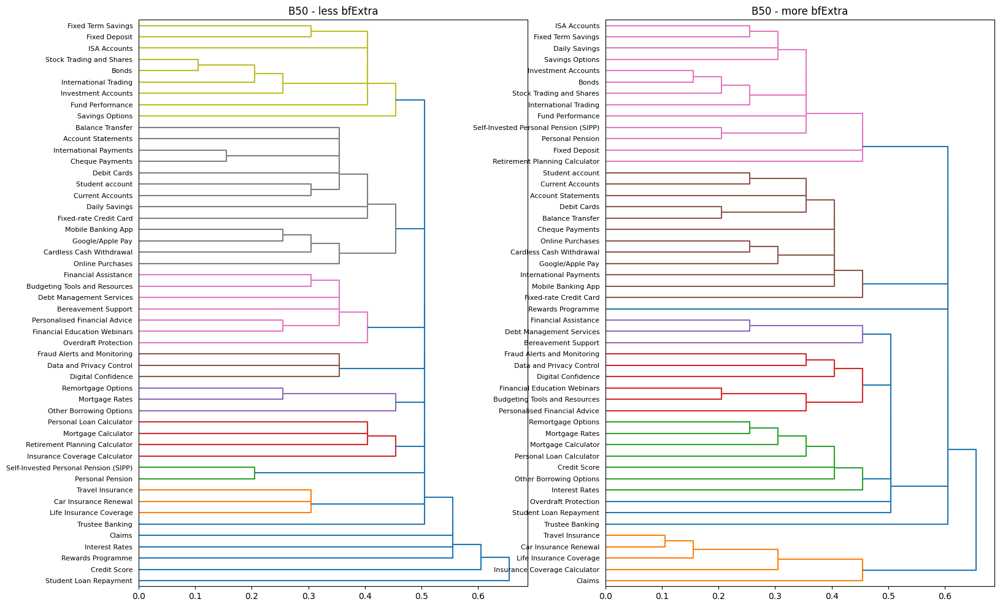

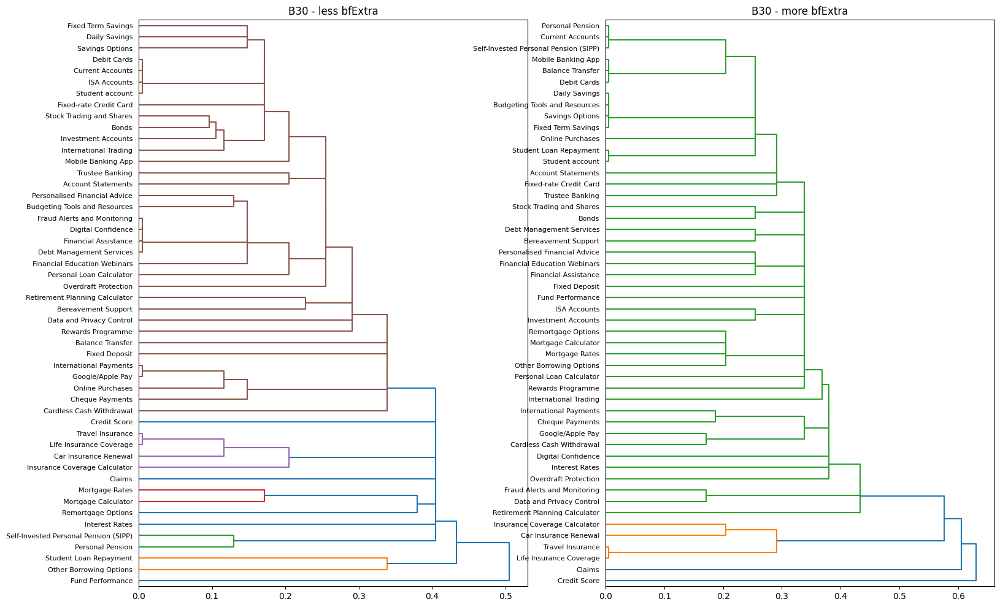

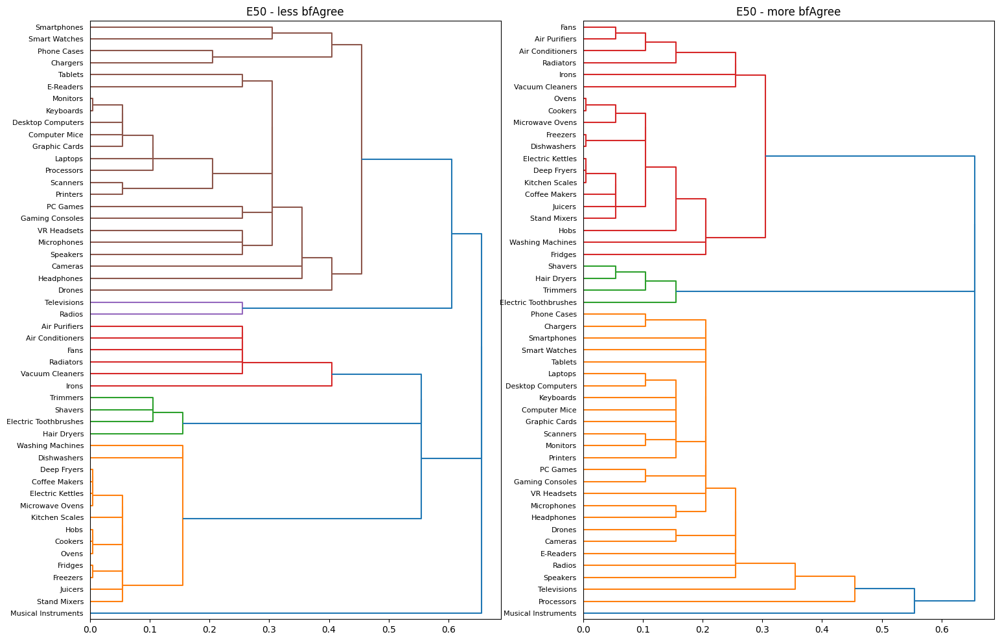

...

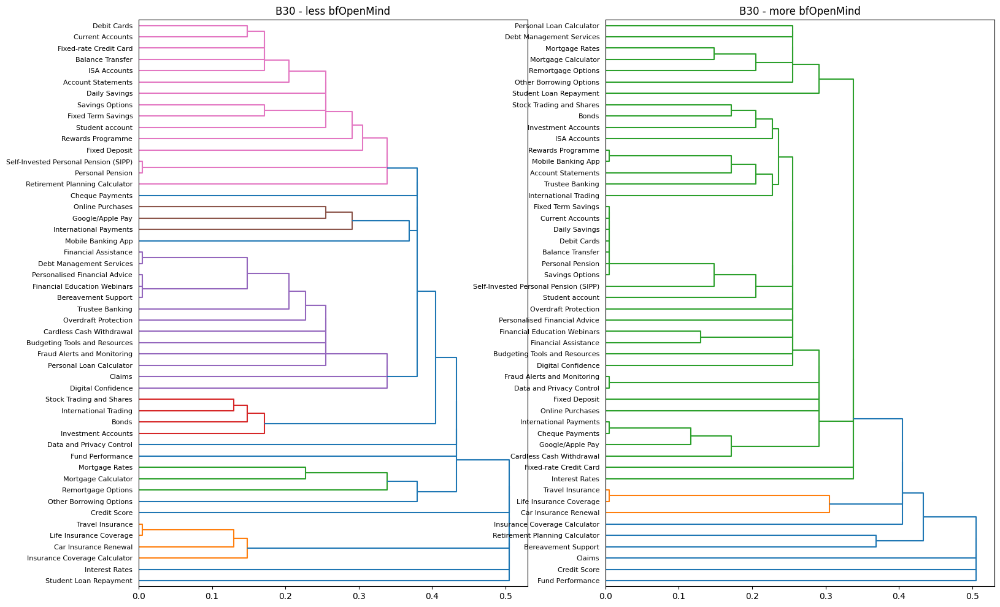

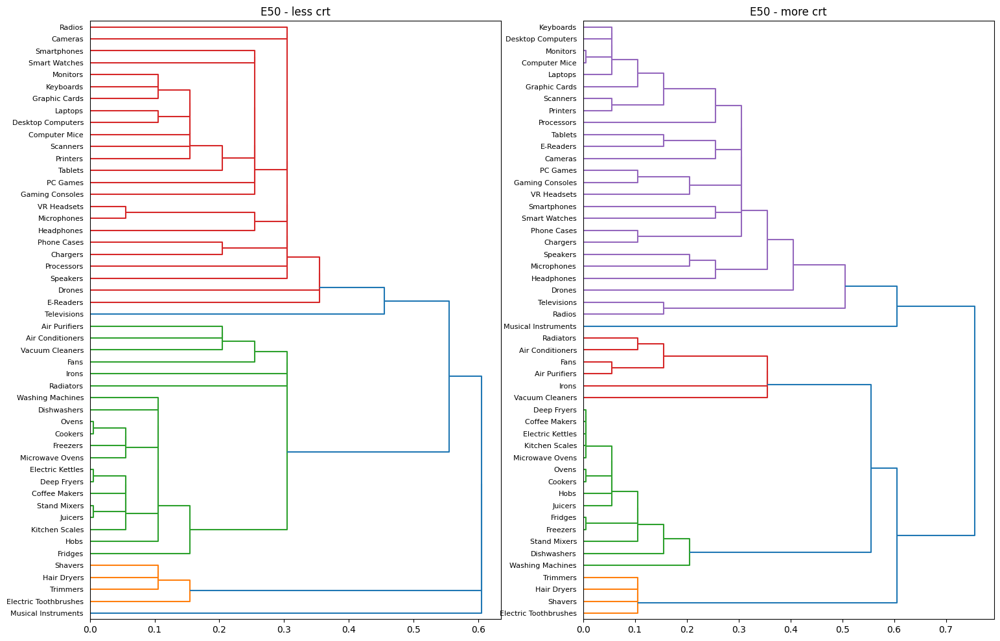

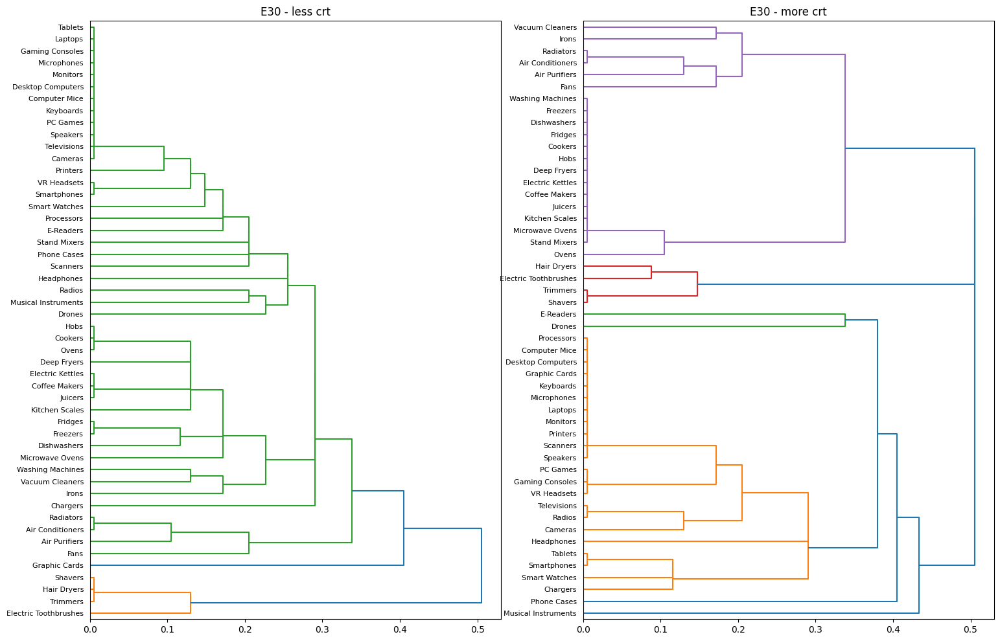

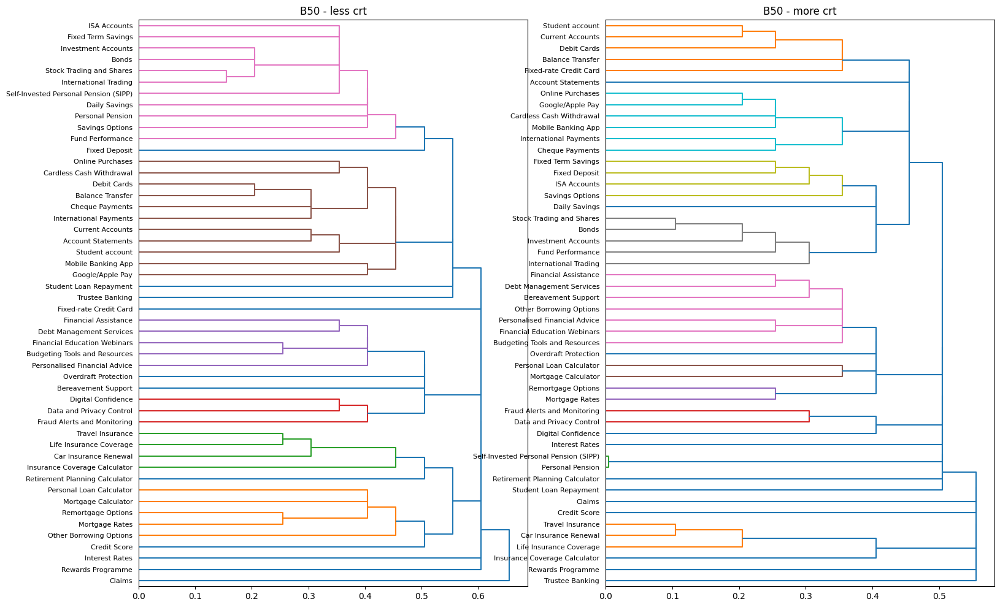

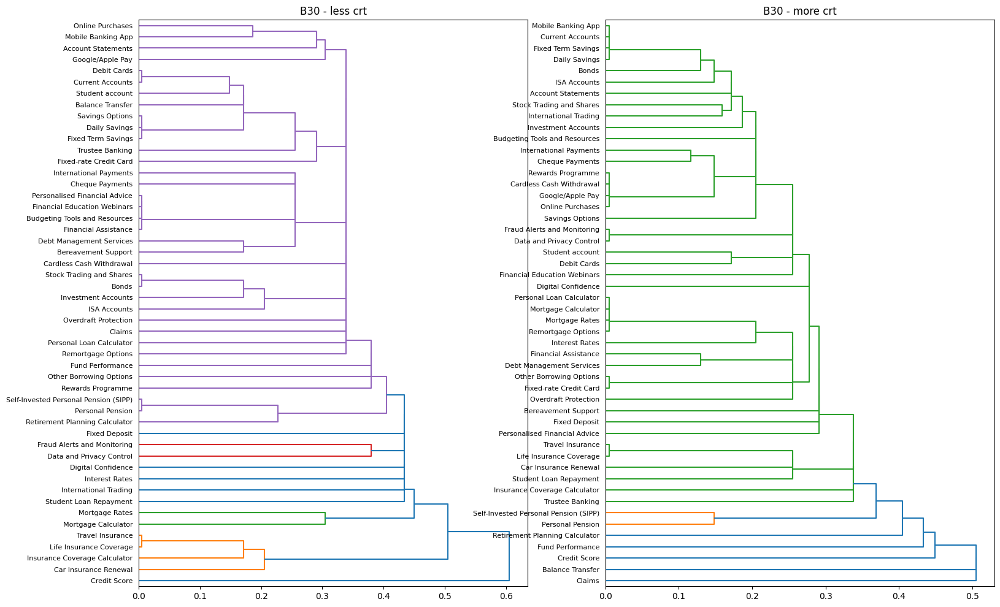

In [5]:
for measure in ['bfExtra', 'bfAgree', 'bfConsc', 'bfNegEmo', 'bfOpenMind', 'crt']:
    for variant in ['E50', 'E30', 'B50', 'B30']:
        i1 = respondents[respondents.variant==variant].sort_values(measure)[:20].respondent.values
        i2 = respondents[respondents.variant==variant].sort_values(measure)[20:].respondent.values
        r1 = results[(results.respondent.isin(i1)) & (results.variant==variant)]
        r2 = results[(results.respondent.isin(i2)) & (results.variant==variant)]
        sim1 = makeMatrix('similarity', r1, cardsE if variant in ['E50', 'E30'] else cardsB, 20)
        sim2 = makeMatrix('similarity', r2, cardsE if variant in ['E50', 'E30'] else cardsB, 20)
        m1 = 1 - (np.matrix(sim1) / 100) + .005
        m2 = 1 - (np.matrix(sim2) / 100) + .005
        np.fill_diagonal(m1, 0)
        np.fill_diagonal(m2, 0)
        l1 = linkage(squareform(m1), method='single')
        l2 = linkage(squareform(m2), method='single')
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 12))
        dendrogram(l1, labels=sim1.index, orientation='right', leaf_font_size=8, ax=ax1)
        ax1.set_title(variant + ' - less ' + measure)
        dendrogram(l2, labels=sim2.index, orientation='right', leaf_font_size=8, ax=ax2)
        ax2.set_title(variant + ' - more ' + measure)

## Clustering MDS

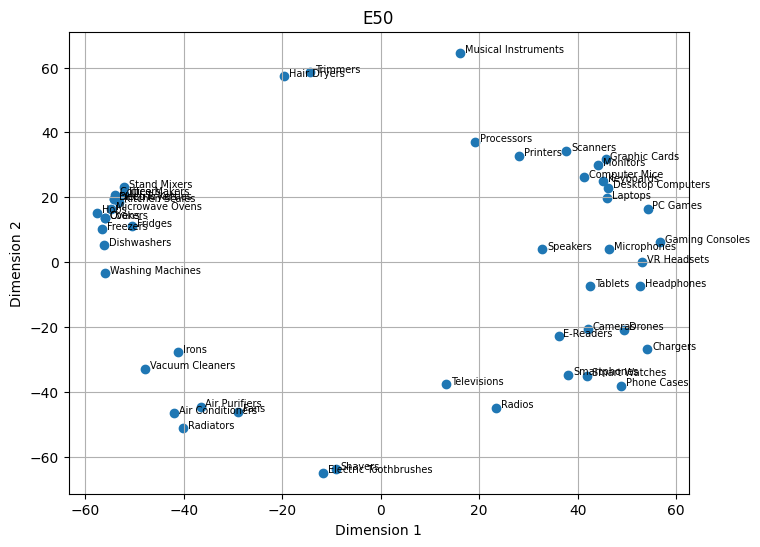

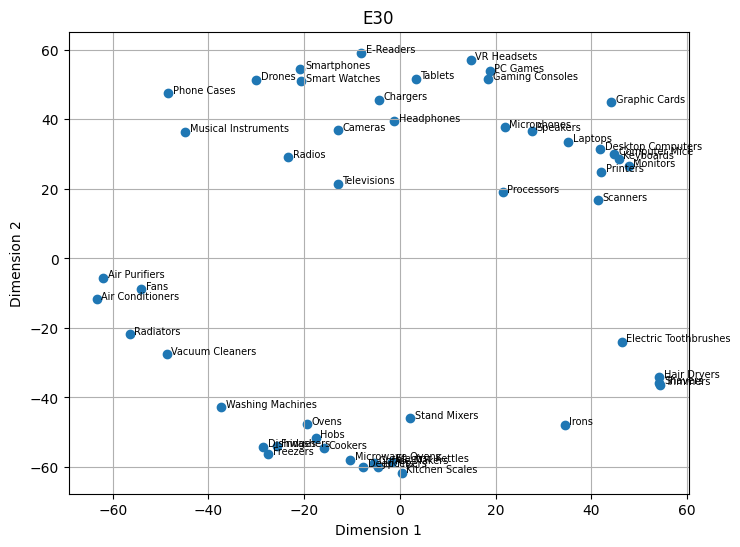

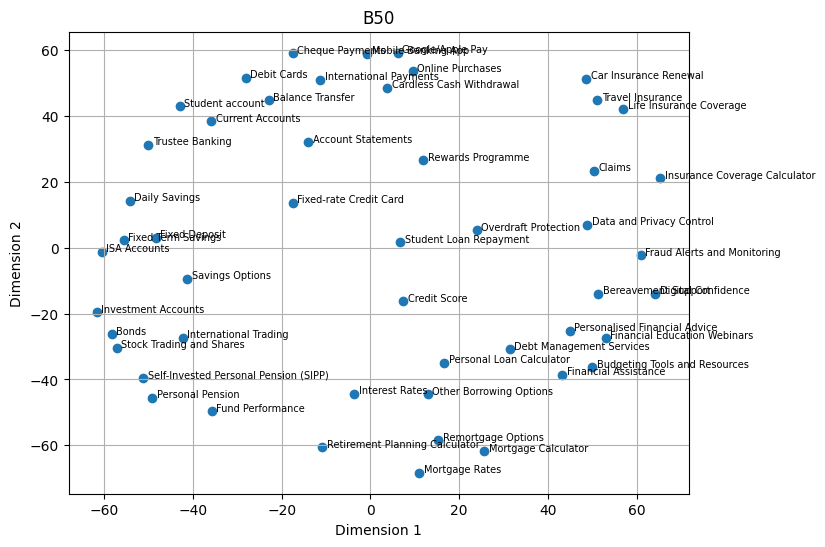

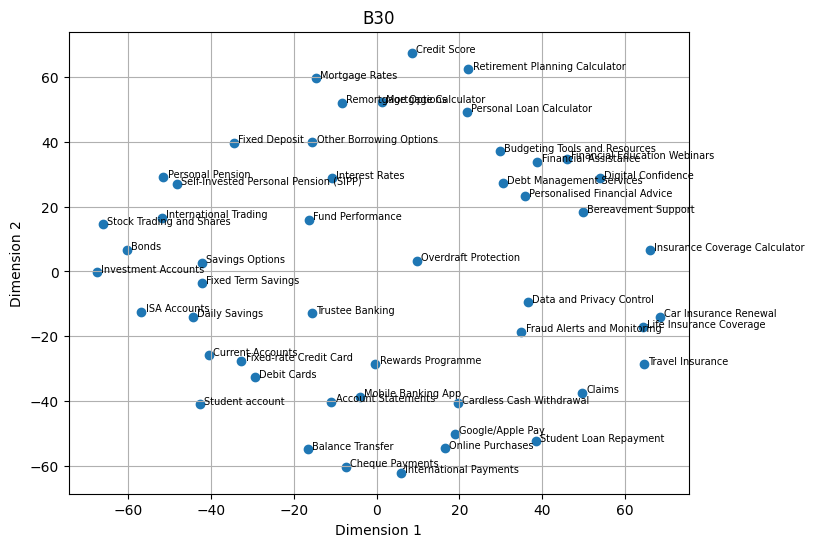

In [6]:
for variant in ['E50', 'E30', 'B50', 'B30']:
    m = makeMatrix('similarity', results[results.variant==variant], cardsE if variant in ['E50', 'E30'] else cardsB, 40)
    d = 100 - m
    mds = MDS(random_state=2, dissimilarity='precomputed')
    embedding = mds.fit_transform(d)

    x_coords = embedding[:, 0]
    y_coords = embedding[:, 1]

    plt.figure(figsize=(8, 6))
    plt.scatter(x_coords, y_coords)

    for i, label in enumerate(cardsE if variant in ['E50', 'E30'] else cardsB):
        plt.text(x_coords[i] + 1, y_coords[i], label, fontsize=7, ha='left')

    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.title(variant)
    plt.grid(True)
    plt.show()

/var/folders/3m/cjzjfzb55vz43fmr0ny8vj6w0000gn/T/ipykernel_5291/1628878309.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))


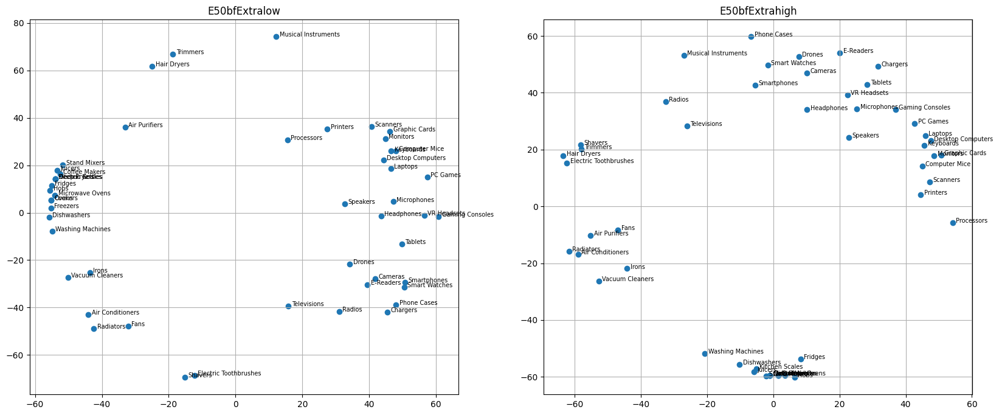

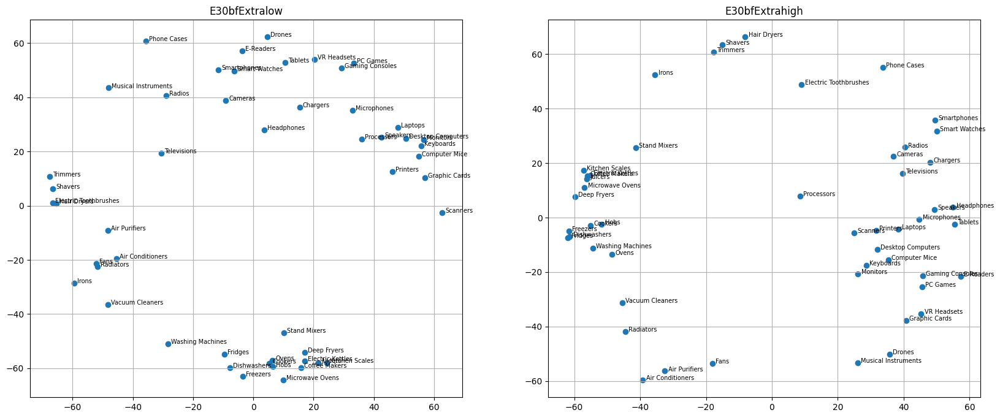

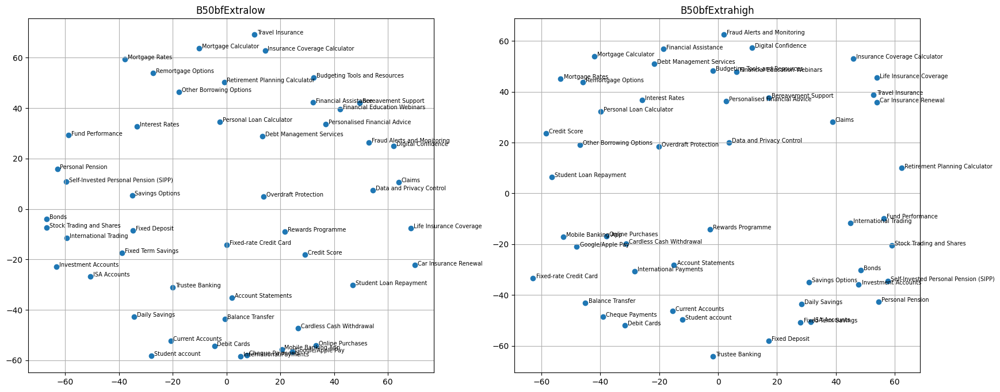

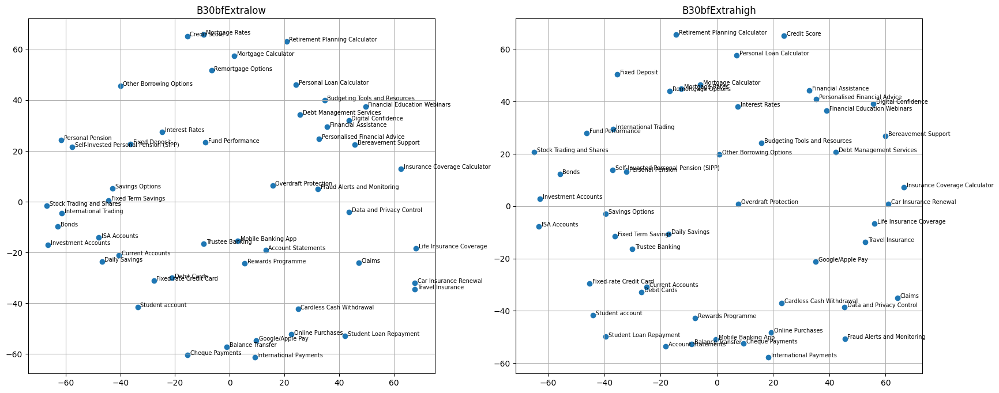

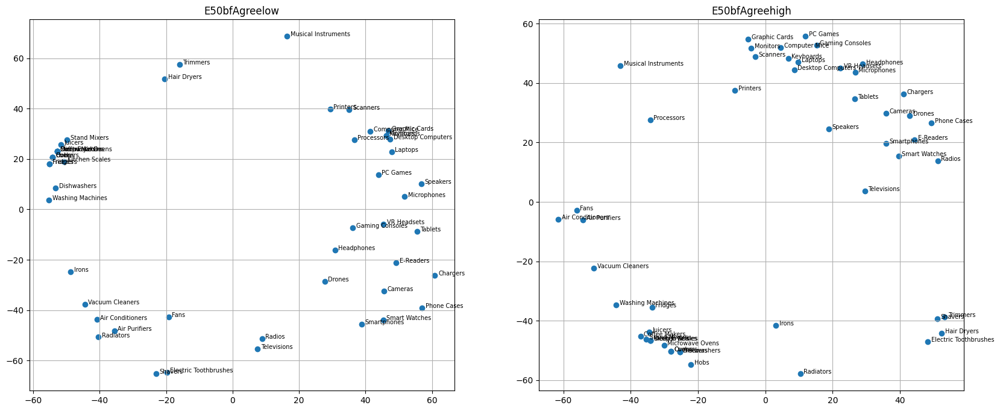

...

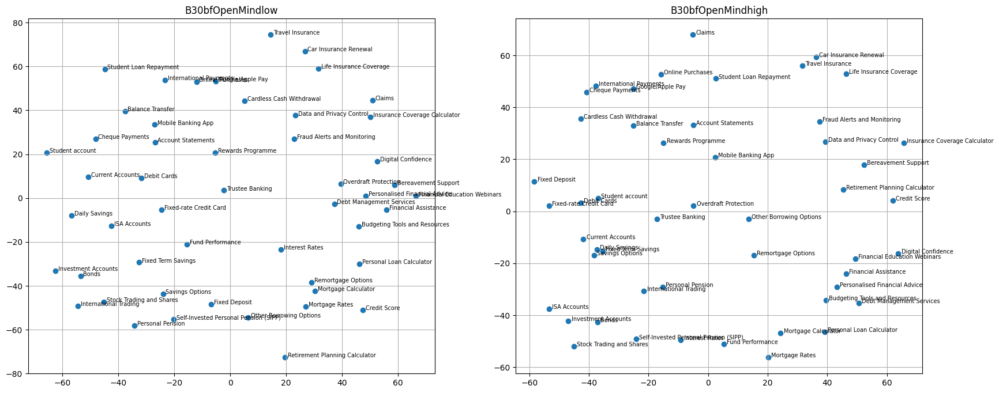

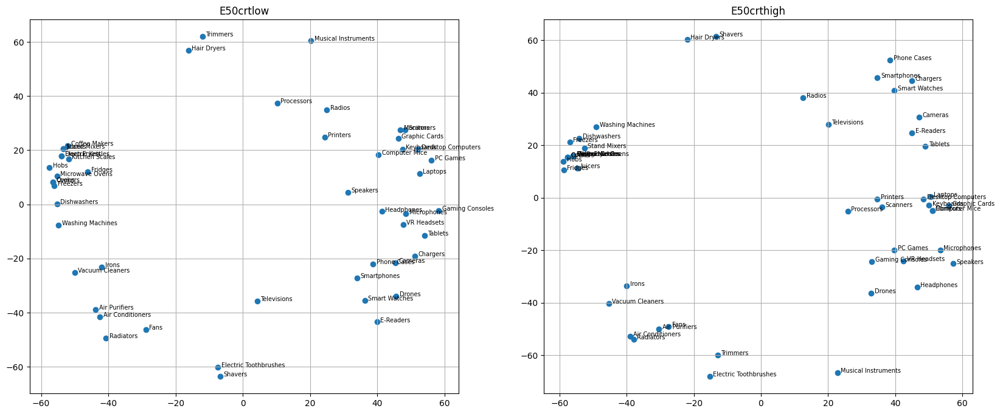

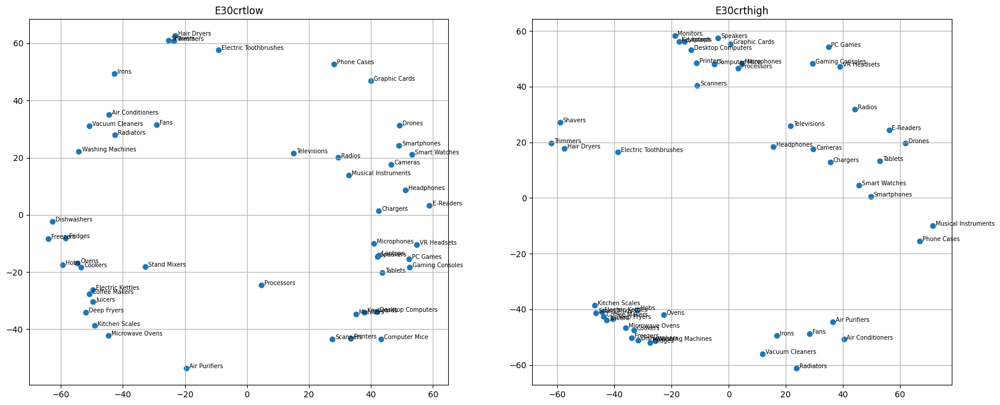

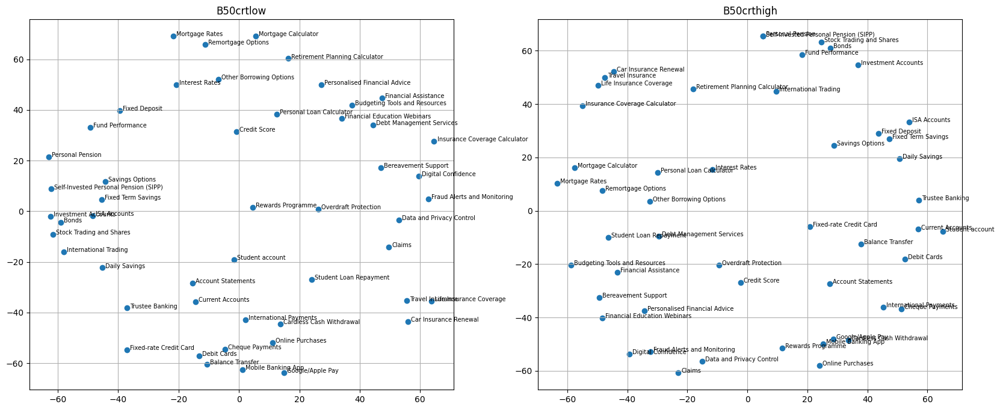

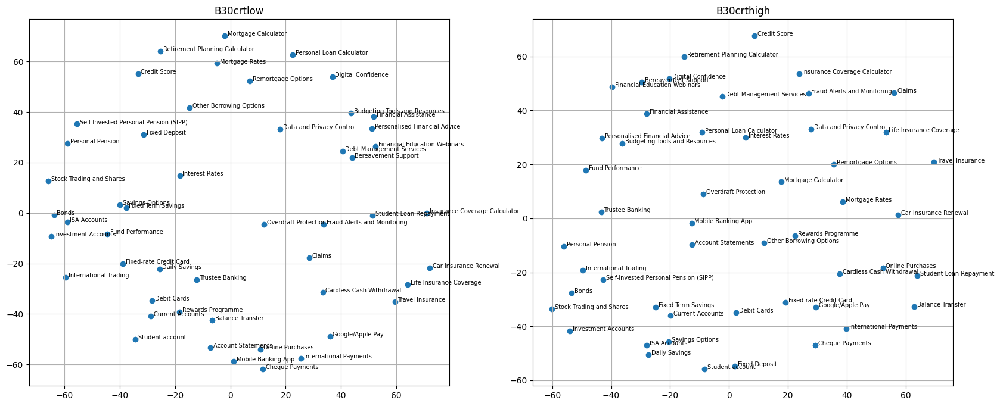

In [7]:
for measure in ['bfExtra', 'bfAgree', 'bfConsc', 'bfNegEmo', 'bfOpenMind', 'crt']:
    for variant in ['E50', 'E30', 'B50', 'B30']:

        r1, r2 = getHalves(respondents, results, variant, measure)
        m1 = makeMatrix('similarity', r1, cardsE if variant in ['E50', 'E30'] else cardsB, 20)
        m2 = makeMatrix('similarity', r2, cardsE if variant in ['E50', 'E30'] else cardsB, 20)
        d1 = 100 - m1
        d2 = 100 - m2

        mds1 = MDS(random_state=2, dissimilarity='precomputed')
        mds2 = MDS(random_state=2, dissimilarity='precomputed')
        embedding1 = mds.fit_transform(d1)
        embedding2 = mds.fit_transform(d2)

        x_coords1 = embedding1[:, 0]
        y_coords1 = embedding1[:, 1]
        x_coords2 = embedding2[:, 0]
        y_coords2 = embedding2[:, 1]

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
        ax1.scatter(x_coords1, y_coords1)
        ax2.scatter(x_coords2, y_coords2)

        for i, label in enumerate(cardsE if variant in ['E50', 'E30'] else cardsB):
            ax1.text(x_coords1[i] + 1, y_coords1[i], label, fontsize=7, ha='left')
            ax2.text(x_coords2[i] + 1, y_coords2[i], label, fontsize=7, ha='left')

        ax1.set_title(variant + measure + 'low')
        ax2.set_title(variant + measure + 'high')
        ax1.grid(True)
        ax2.grid(True)

## Clustering K-means

In [8]:
wcss = {}
silhouetteScores = {}
for variant in ['E50', 'E30', 'B50', 'B30']:

    m = 100 - makeMatrix('similarity', results[results.variant==variant], cardsE if variant in ['E50', 'E30'] else cardsB, 40)
    mds = MDS(random_state=2, dissimilarity='precomputed', n_components=3)
    embedding = mds.fit_transform(m)

    wcss[variant] = []
    silhouetteScores[variant] = []

    for i in range(0, 20):
        if(i < 2):
            wcss[variant].append(np.nan)
            silhouetteScores[variant].append(np.nan)
            continue
        kmeans = KMeans(n_clusters=i, random_state=0)
        clusters = kmeans.fit_predict(embedding)
        wcss[variant].append(kmeans.inertia_)
        score = silhouette_score(m, clusters)
        silhouetteScores[variant].append(score)

<Axes: >

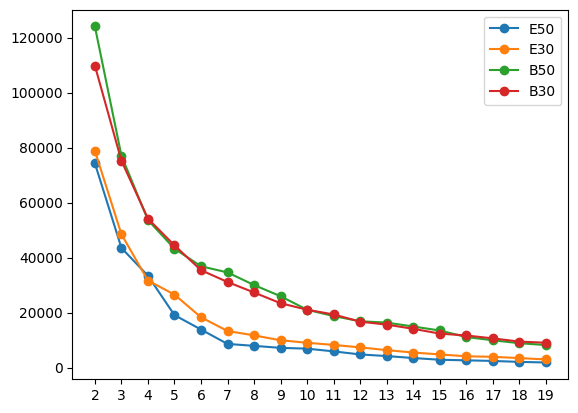

In [9]:
pd.DataFrame(wcss).plot(xticks=np.arange(2, 20), marker='o', linestyle='-')

<Axes: >

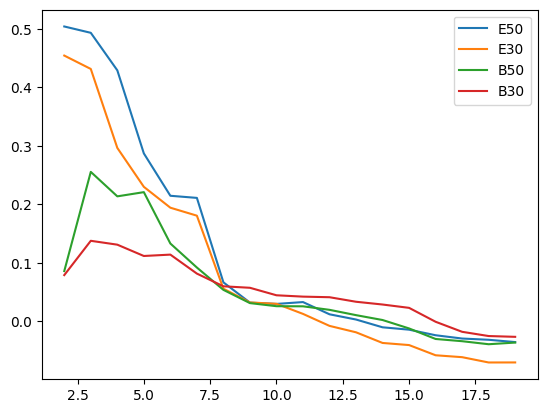

In [10]:
pd.DataFrame(silhouetteScores).plot()

In [11]:
# # iba print
# _, hist = makeMatrix('C-similarity', results[results.variant=='E30'], cardsE, 40, clusterHistory=True)
# for i in hist[-]['clusters']:
#     print(', '.join(i))

Drones, Gaming Consoles, Headphones, Microphones, Musical Instruments, Speakers, VR Headsets
Coffee Makers, Cookers, Deep Fryers, Dishwashers, Electric Kettles, Freezers, Fridges, Hobs, Juicers, Kitchen Scales, Microwave Ovens, Ovens, Stand Mixers, Washing Machines
Air Conditioners, Air Purifiers, Fans, Irons, Radiators, Vacuum Cleaners
Electric Toothbrushes, Hair Dryers, Shavers, Trimmers
Cameras, Chargers, E-Readers, Phone Cases, Radios, Smart Watches, Smartphones, Tablets, Televisions
Computer Mice, Desktop Computers, Graphic Cards, Keyboards, Laptops, Monitors, PC Games, Printers, Processors, Scanners


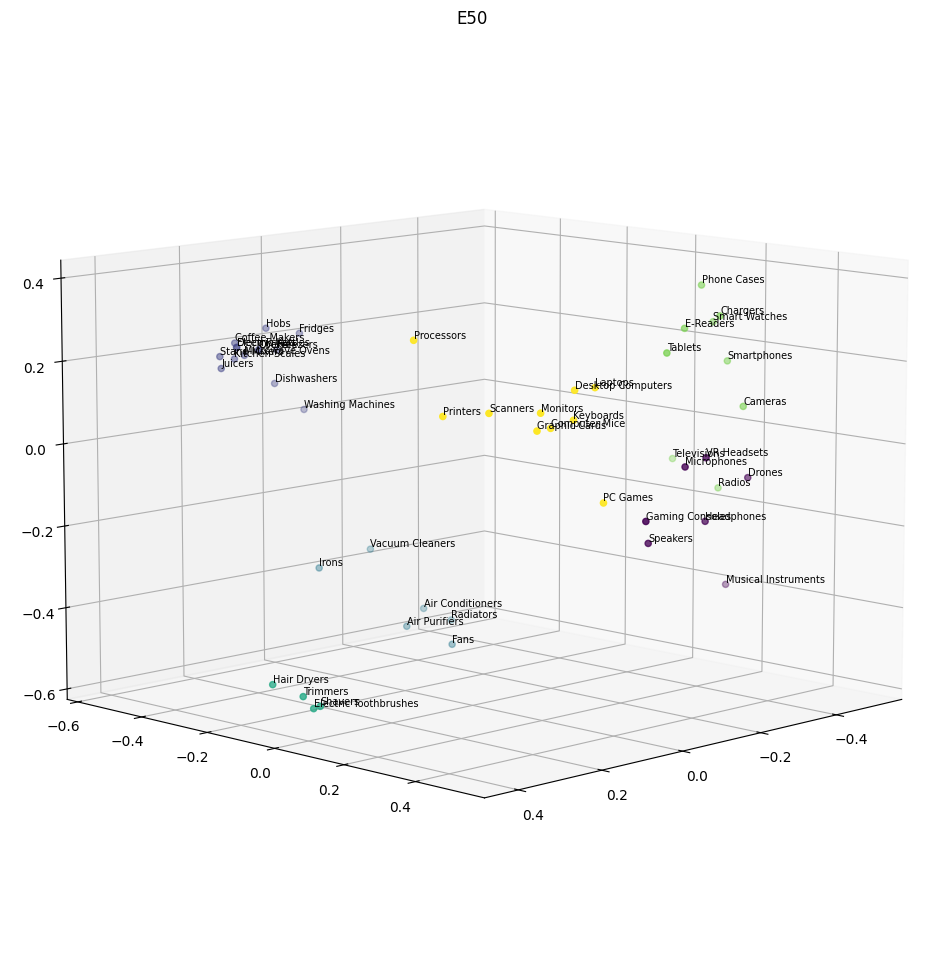

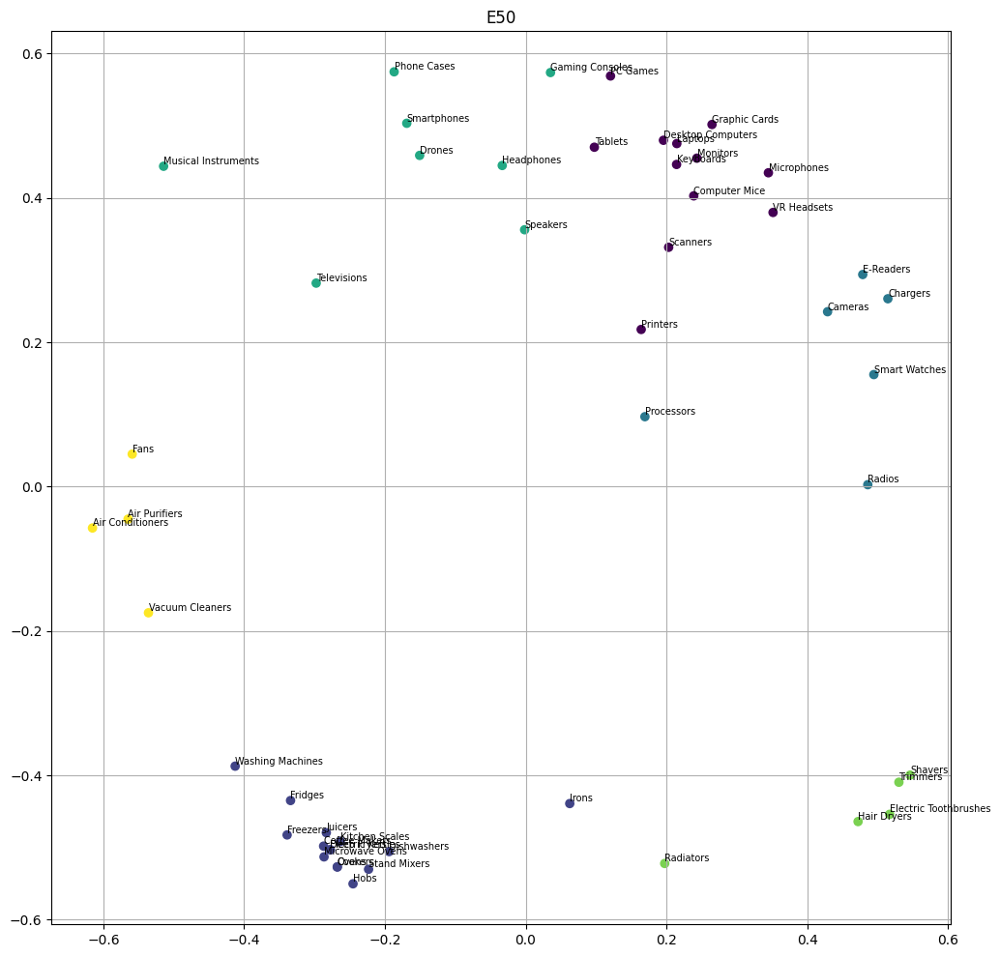

Computer Mice, Desktop Computers, Keyboards, Laptops, Microphones, Monitors, Printers, Scanners, Speakers
Coffee Makers, Cookers, Deep Fryers, Dishwashers, Electric Kettles, Freezers, Fridges, Hobs, Juicers, Kitchen Scales, Microwave Ovens, Ovens, Stand Mixers, Washing Machines
Electric Toothbrushes, Hair Dryers, Irons, Shavers, Trimmers
Drones, Gaming Consoles, Graphic Cards, PC Games, Processors, Tablets, VR Headsets
Cameras, Chargers, E-Readers, Headphones, Musical Instruments, Phone Cases, Radios, Smart Watches, Smartphones, Televisions
Air Conditioners, Air Purifiers, Fans, Radiators, Vacuum Cleaners


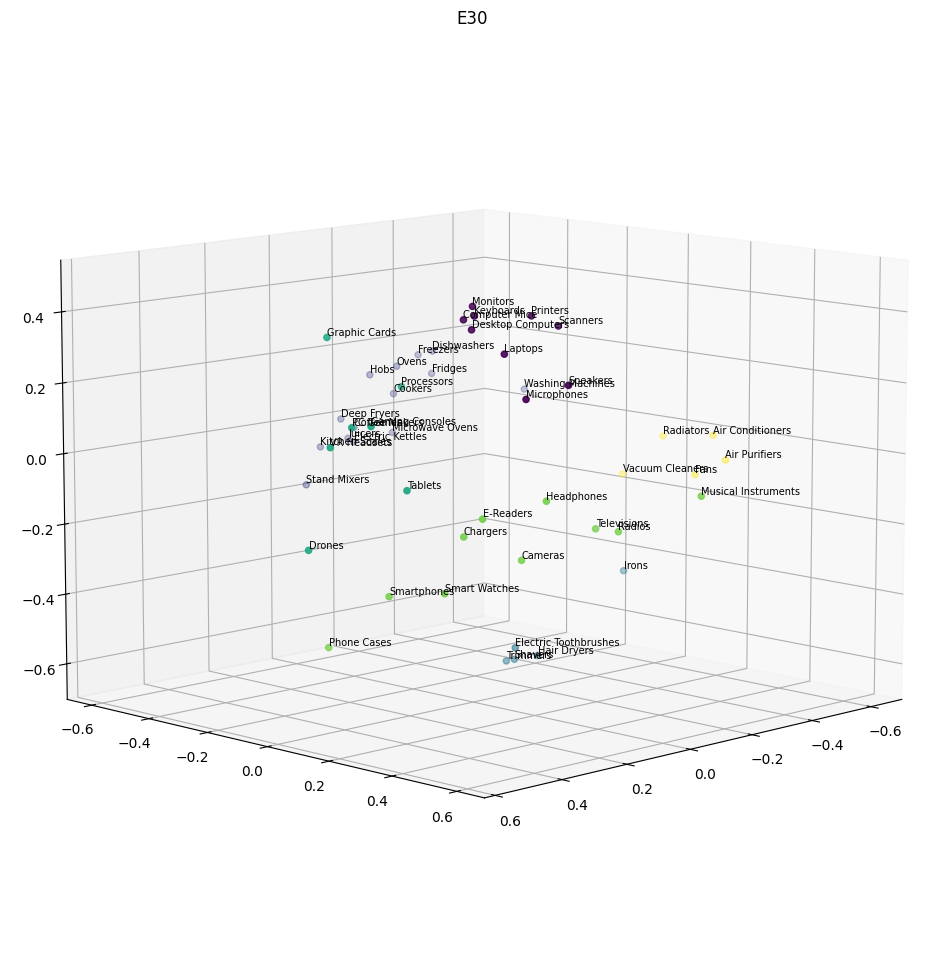

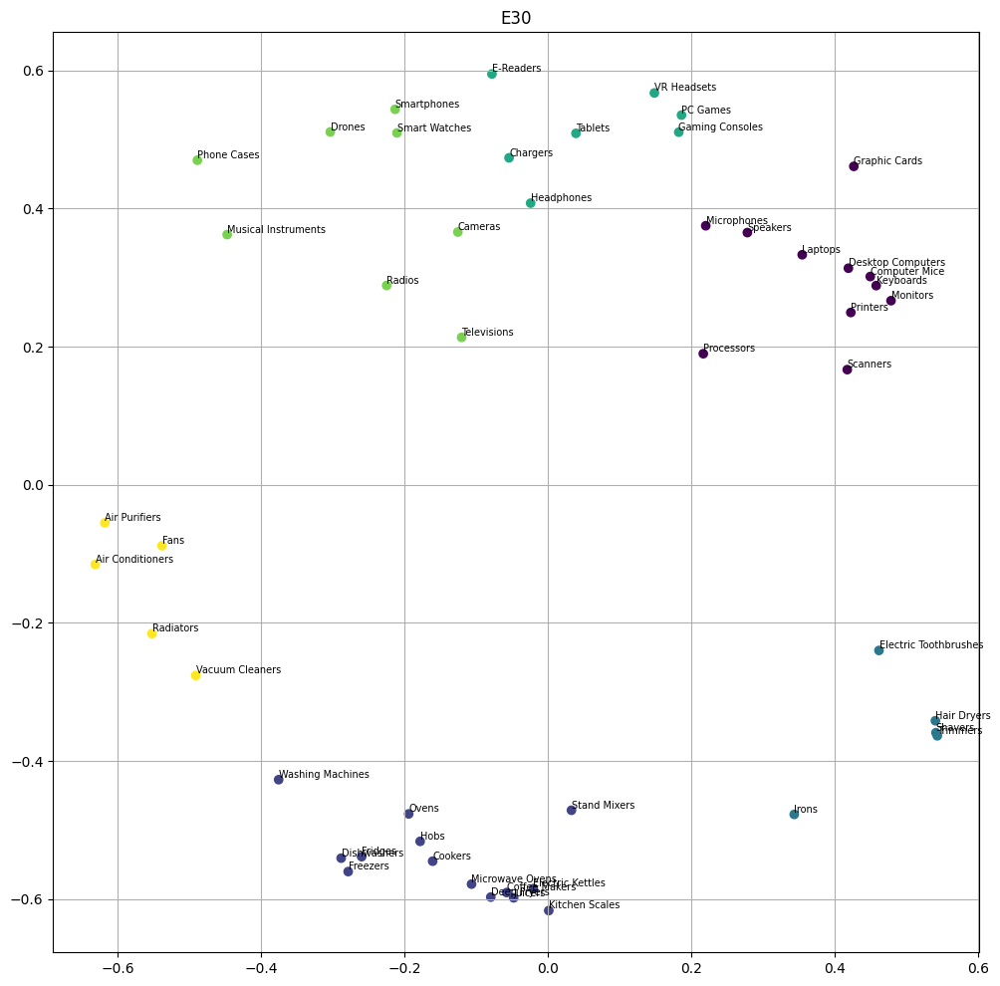

Bonds, Daily Savings, Fixed Deposit, Fixed Term Savings, Fund Performance, International Trading, Investment Accounts, ISA Accounts, Personal Pension, Savings Options, Self-Invested Personal Pension (SIPP), Stock Trading and Shares
Account Statements, Balance Transfer, Cardless Cash Withdrawal, Cheque Payments, Current Accounts, Debit Cards, Google/Apple Pay, International Payments, Mobile Banking App, Online Purchases, Student account
Bereavement Support, Budgeting Tools and Resources, Data and Privacy Control, Debt Management Services, Digital Confidence, Financial Assistance, Financial Education Webinars, Fraud Alerts and Monitoring, Overdraft Protection, Personalised Financial Advice, Rewards Programme
Claims, Insurance Coverage Calculator, Interest Rates, Mortgage Calculator, Retirement Planning Calculator
Credit Score, Fixed-rate Credit Card, Mortgage Rates, Other Borrowing Options, Personal Loan Calculator, Remortgage Options, Student Loan Repayment
Car Insurance Renewal, Life I

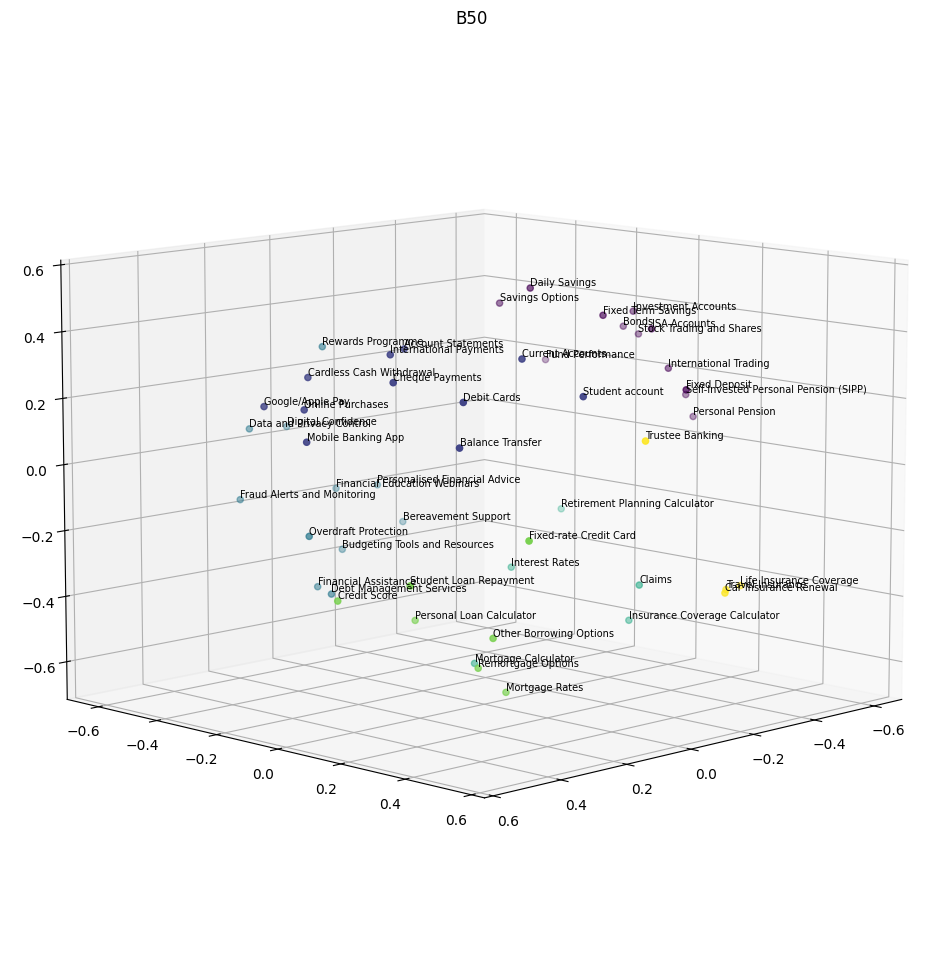

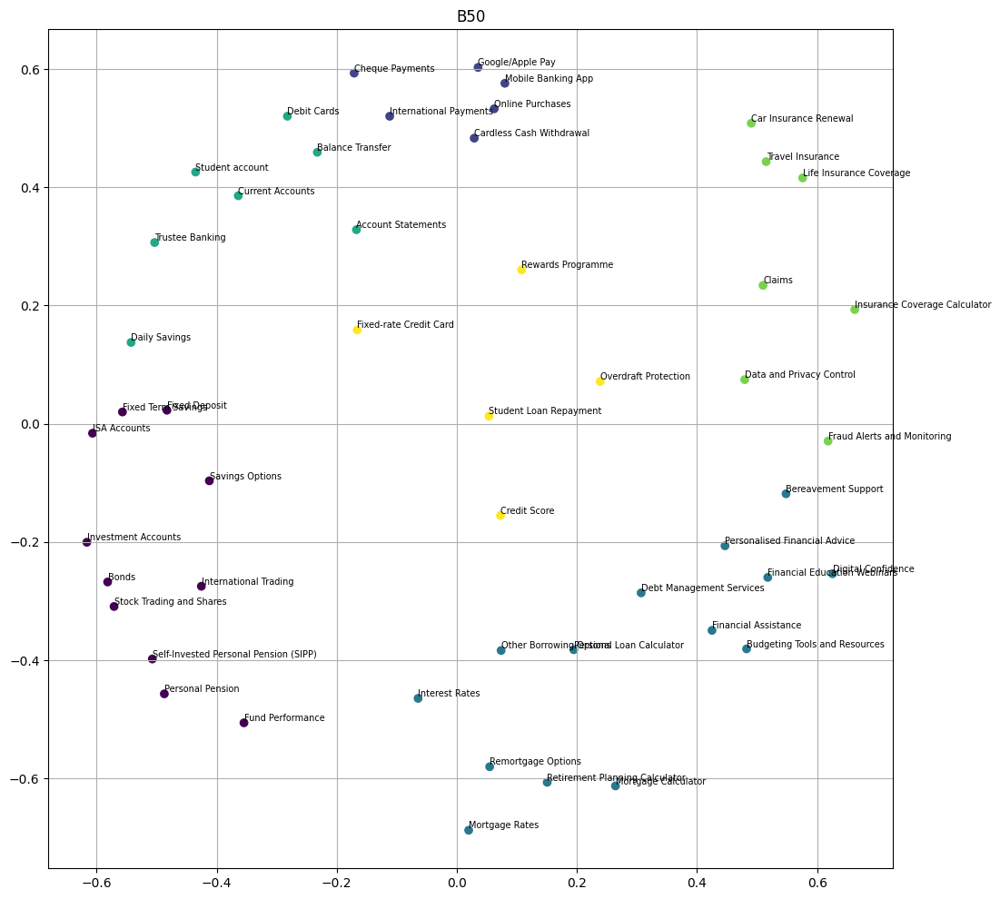

Bonds, Fund Performance, International Trading, Investment Accounts, Personal Pension, Retirement Planning Calculator, Self-Invested Personal Pension (SIPP), Stock Trading and Shares, Trustee Banking
Account Statements, Balance Transfer, Cardless Cash Withdrawal, Cheque Payments, Claims, Google/Apple Pay, International Payments, Mobile Banking App, Online Purchases, Rewards Programme
Credit Score, Interest Rates, Mortgage Calculator, Mortgage Rates, Other Borrowing Options, Personal Loan Calculator, Remortgage Options
Bereavement Support, Budgeting Tools and Resources, Data and Privacy Control, Debt Management Services, Digital Confidence, Financial Assistance, Financial Education Webinars, Fraud Alerts and Monitoring, Overdraft Protection, Personalised Financial Advice
Current Accounts, Daily Savings, Debit Cards, Fixed Deposit, Fixed Term Savings, Fixed-rate Credit Card, ISA Accounts, Savings Options, Student account
Car Insurance Renewal, Insurance Coverage Calculator, Life Insuranc

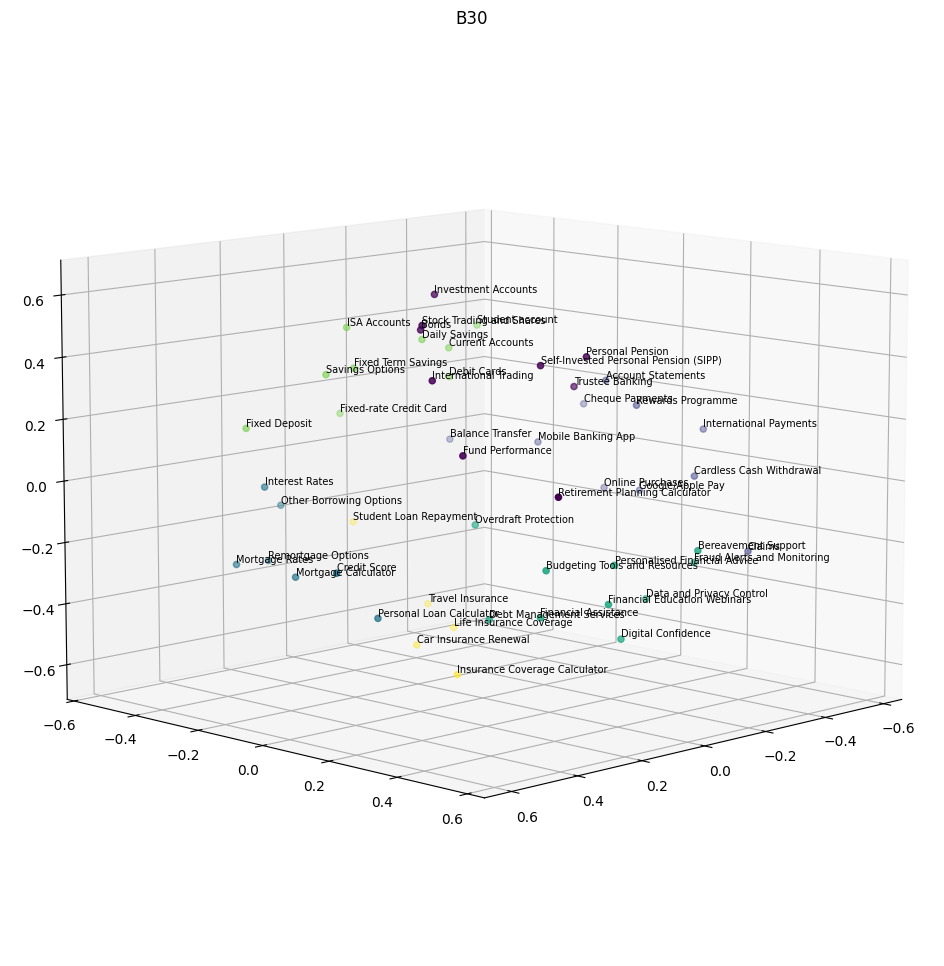

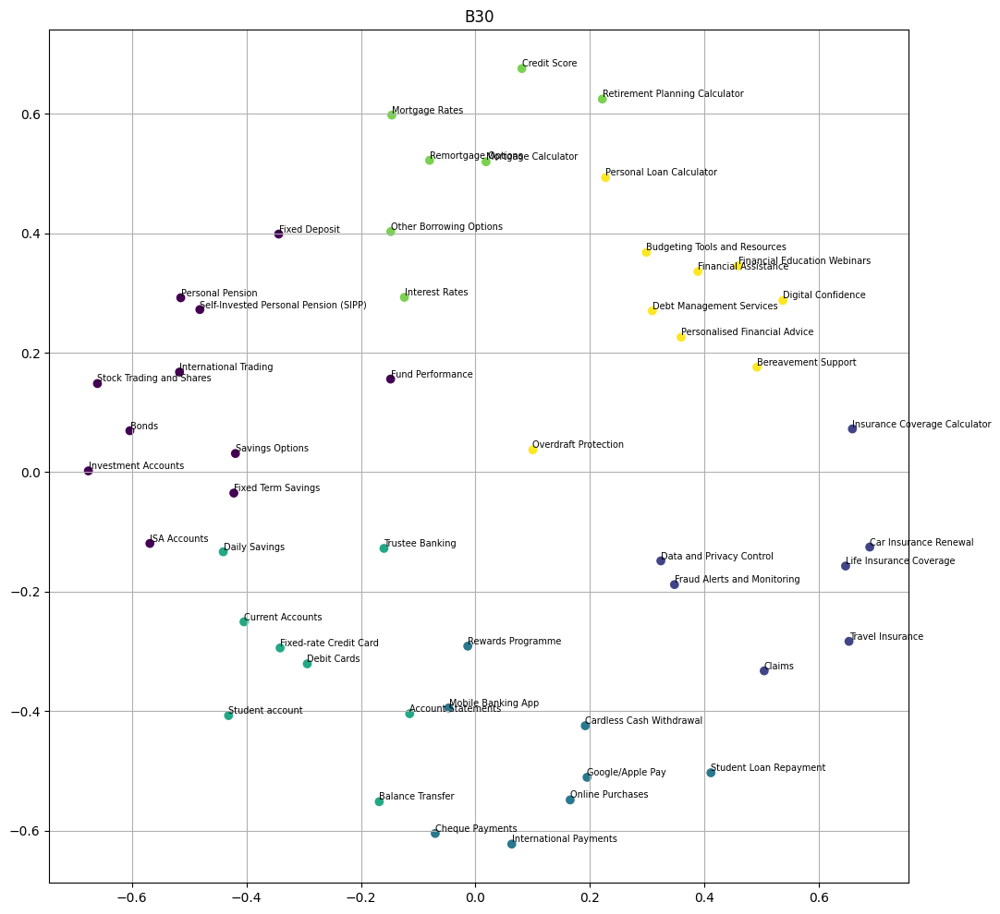

In [12]:
for variant in ['E50', 'E30', 'B50', 'B30']:
    m = (100 - makeMatrix('similarity', results[results.variant==variant], cardsE if variant in ['E50', 'E30'] else cardsB, 40)) / 100
    mds = MDS(random_state=2, dissimilarity='precomputed', n_components=3)
    embedding = mds.fit_transform(m)
    kmeans = KMeans(n_clusters=6, random_state=0)
    clusters = kmeans.fit_predict(embedding)

    x_coords = embedding[:, 0]
    y_coords = embedding[:, 1]
    z_coords = embedding[:, 2]

    fig = plt.figure(figsize=(12, 12))
    ax = fig.add_subplot(projection='3d')
    for i in range(6):
        print(', '.join(cardsE[clusters == i] if variant in ['E50', 'E30'] else cardsB[clusters == i]))
    ax.scatter(x_coords, y_coords, z_coords, c=clusters, cmap='viridis', marker='o')

    for i, label in enumerate(cardsE if variant in ['E50', 'E30'] else cardsB):
        ax.text(x_coords[i], y_coords[i], z_coords[i], label, fontsize=7, ha='left', va='bottom')

    ax.set_title(variant)
    ax.view_init(elev=10, azim=45)
    plt.show()


    mds = MDS(random_state=2, dissimilarity='precomputed', n_components=2)
    embedding = mds.fit_transform(m)
    kmeans = KMeans(n_clusters=6, random_state=0)
    clusters = kmeans.fit_predict(embedding)

    x_coords = embedding[:, 0]
    y_coords = embedding[:, 1]

    fig = plt.figure(figsize=(12, 12))
    ax = fig.add_subplot()
    ax.scatter(x_coords, y_coords, c=clusters, cmap='viridis', marker='o')

    for i, label in enumerate(cardsE if variant in ['E50', 'E30'] else cardsB):
        ax.text(x_coords[i], y_coords[i], label, fontsize=7, ha='left', va='bottom')

    ax.set_title(variant)
    ax.grid(True)
    plt.show()
    

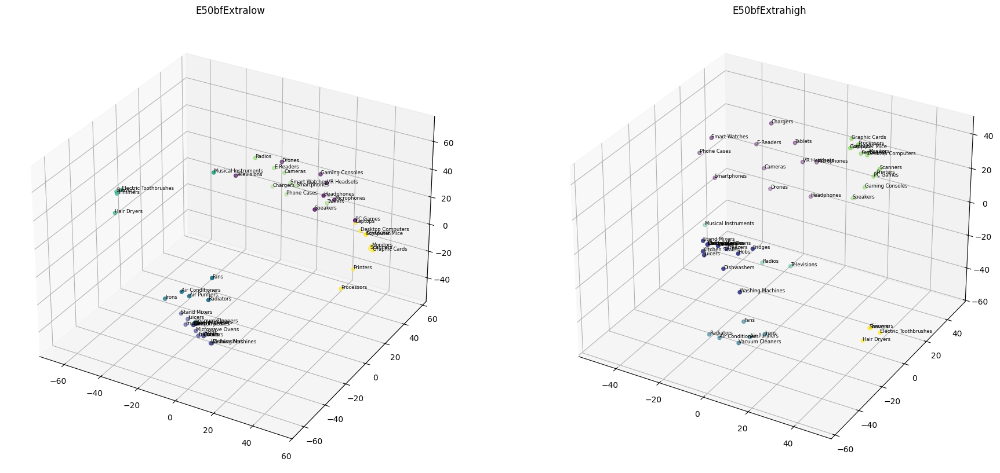

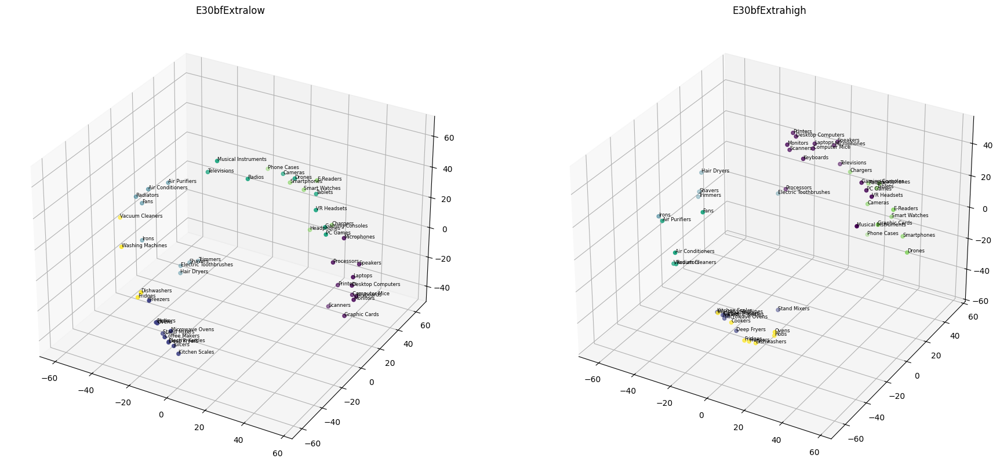

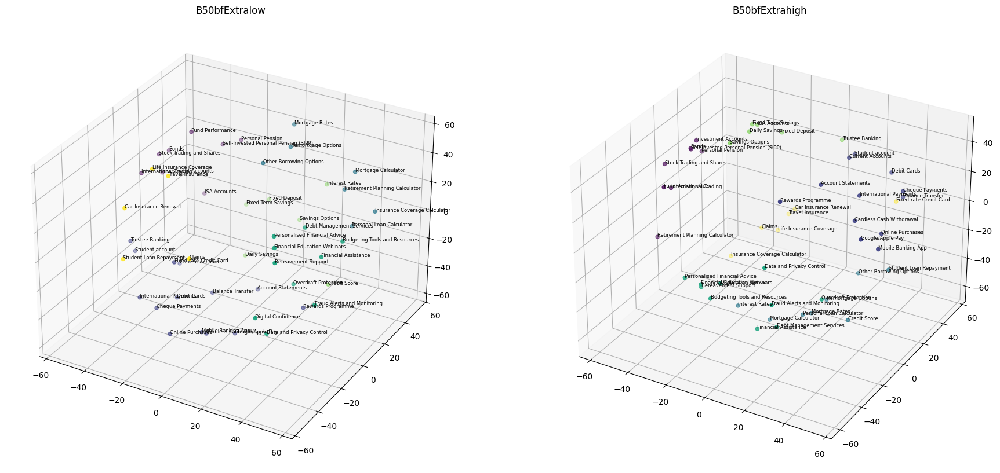

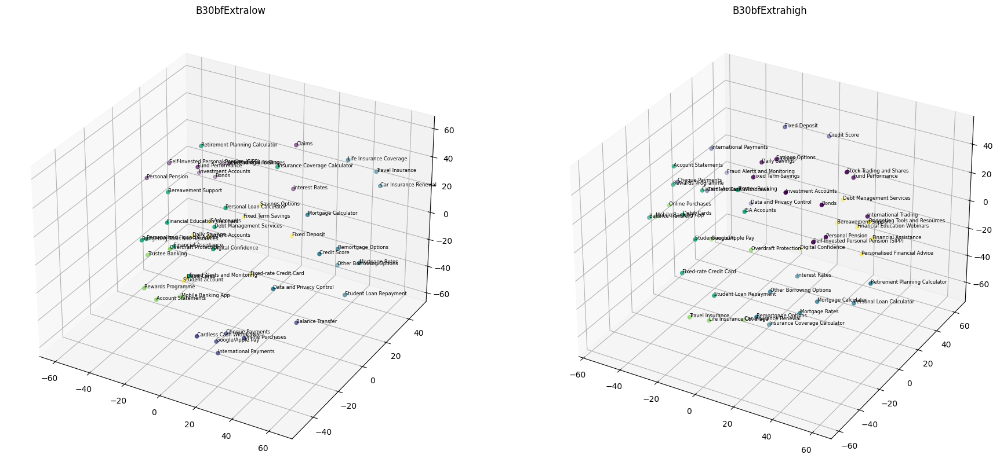

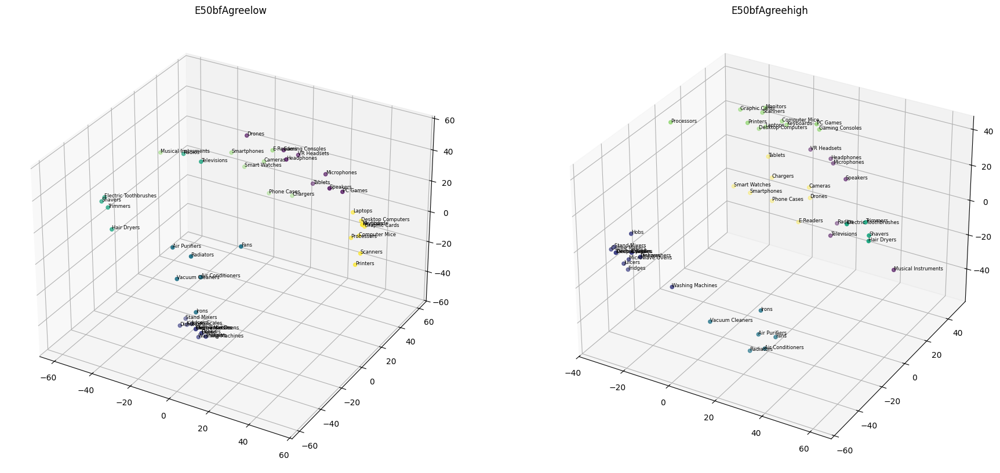

...

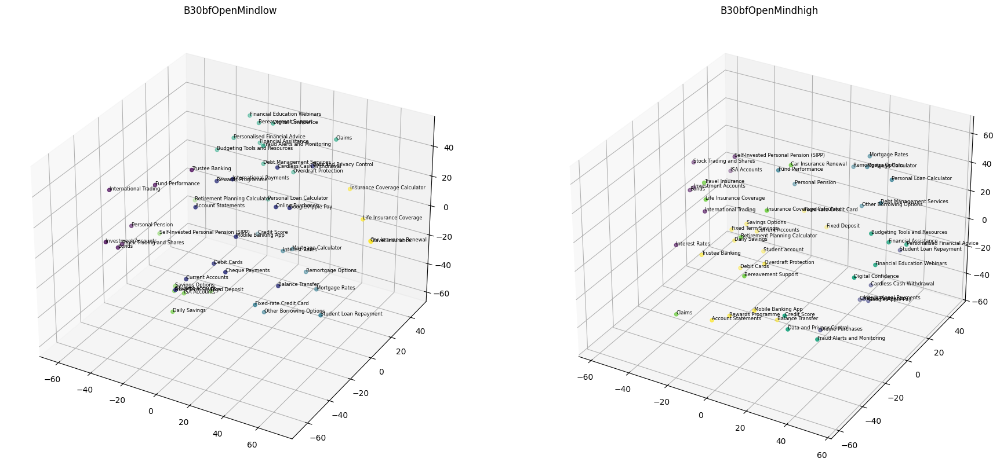

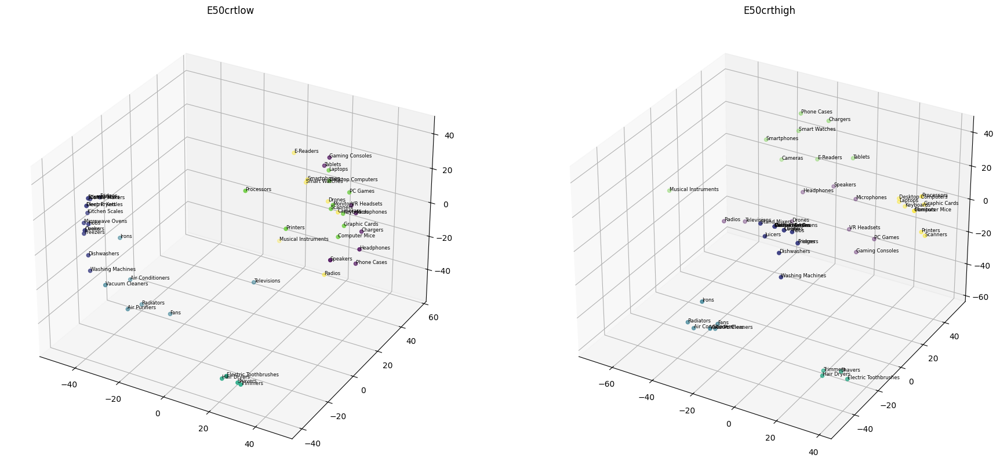

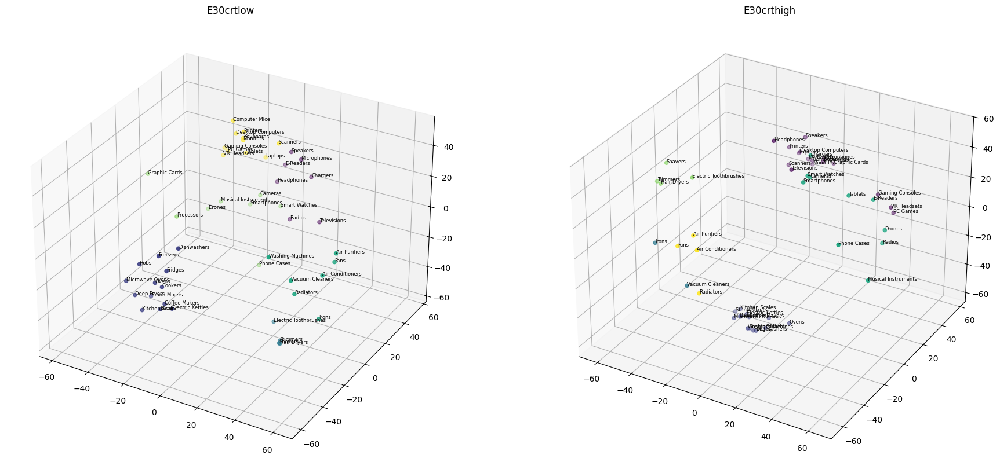

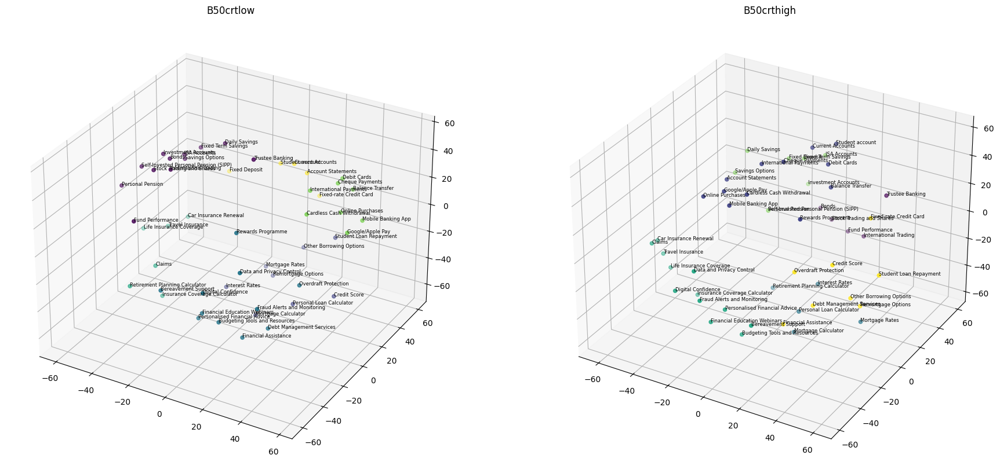

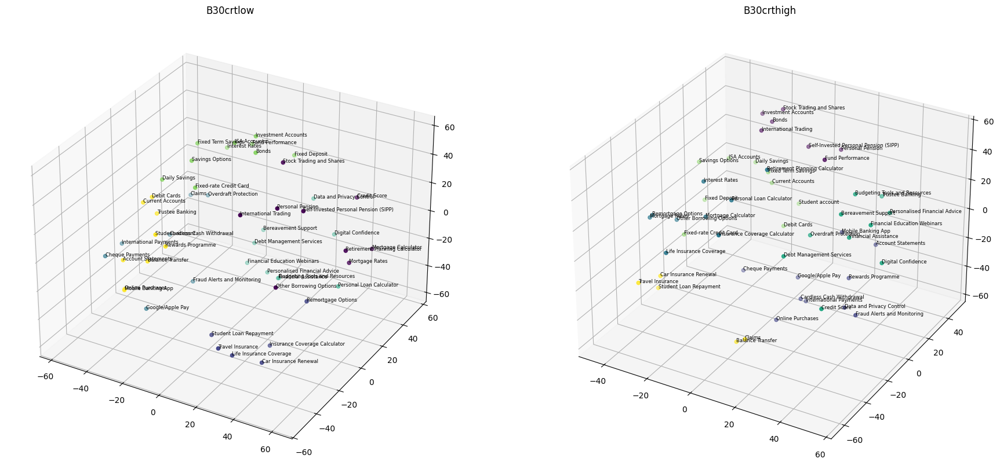

In [27]:
for measure in ['bfExtra', 'bfAgree', 'bfConsc', 'bfNegEmo', 'bfOpenMind', 'crt']:
    for variant in ['E50', 'E30', 'B50', 'B30']:

        r1, r2 = getHalves(respondents, results, variant, measure)
        m1 = makeMatrix('similarity', r1, cardsE if variant in ['E50', 'E30'] else cardsB, 20)
        m2 = makeMatrix('similarity', r2, cardsE if variant in ['E50', 'E30'] else cardsB, 20)
        d1 = 100 - m1
        d2 = 100 - m2

        mds1 = MDS(random_state=2, dissimilarity='precomputed', n_components=3)
        mds2 = MDS(random_state=2, dissimilarity='precomputed', n_components=3)
        embedding1 = mds1.fit_transform(d1)
        embedding2 = mds2.fit_transform(d2)

        kmeans1 = KMeans(n_clusters=6, random_state=0)
        clusters1 = kmeans.fit_predict(embedding1)
        kmeans2 = KMeans(n_clusters=6, random_state=0)
        clusters2 = kmeans.fit_predict(embedding2)

        x_coords1 = embedding1[:, 0]
        y_coords1 = embedding1[:, 1]
        z_coords1 = embedding1[:, 2]
        x_coords2 = embedding2[:, 0]
        y_coords2 = embedding2[:, 1]
        z_coords2 = embedding2[:, 2]

        fig = plt.figure(figsize=(22, 14))
        # axs = fig.subplots(1, 2)
        # axs[0, 1].remove()
        #ax1 = fig.add_subplot()
        ax1 = fig.add_subplot(1, 2, 1, projection='3d')
        ax2 = fig.add_subplot(1, 2, 2, projection='3d')
        #fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
        ax1.scatter(x_coords1, y_coords1, z_coords1, c=clusters1, cmap='viridis', marker='o')
        ax2.scatter(x_coords2, y_coords2, z_coords2, c=clusters2, cmap='viridis', marker='o')

        for i, label in enumerate(cardsE if variant in ['E50', 'E30'] else cardsB):
            ax1.text(x_coords1[i], y_coords1[i], z_coords1[i], label, fontsize=6, ha='left')
            ax2.text(x_coords2[i], y_coords2[i], z_coords2[i], label, fontsize=6, ha='left')

        ax1.set_title(variant + measure + 'low')
        ax2.set_title(variant + measure + 'high')  

        plt.show()      

In [ ]:
def clusterK(m, variant):
    m = (100 - m) / 100
    mds = MDS(random_state=2, dissimilarity='precomputed', n_components=3)
    embedding = mds.fit_transform(m)
    kmeans = KMeans(n_clusters=6, random_state=0)
    clusters = kmeans.fit_predict(embedding)

    x_coords = embedding[:, 0]
    y_coords = embedding[:, 1]
    z_coords = embedding[:, 2]

    fig = plt.figure(figsize=(12, 12))
    ax = fig.add_subplot(projection='3d')
    for i in range(6):
        print(', '.join(cardsE[clusters == i] if variant in ['E50', 'E30'] else cardsB[clusters == i]))
    ax.scatter(x_coords, y_coords, z_coords, c=clusters, cmap='viridis', marker='o')

    for i, label in enumerate(cardsE if variant in ['E50', 'E30'] else cardsB):
        ax.text(x_coords[i], y_coords[i], z_coords[i], label, fontsize=7, ha='left', va='bottom')

    ax.set_title(variant)
    ax.view_init(elev=10, azim=45)
    plt.show()
